In [1]:
import numpy as np
import matplotlib.pyplot as plt
import ollama
import time
from PIL import Image
import textwrap

In [2]:
print(ollama.list().models)
model = ollama.list().models[0].model
print(model)

[Model(model='nomic-embed-text:latest', modified_at=datetime.datetime(2025, 4, 13, 23, 46, 15, 419269, tzinfo=TzInfo(+02:00)), digest='0a109f422b47e3a30ba2b10eca18548e944e8a23073ee3f3e947efcf3c45e59f', size=274302450, details=ModelDetails(parent_model='', format='gguf', family='nomic-bert', families=['nomic-bert'], parameter_size='137M', quantization_level='F16')), Model(model='deepseek-r1:8b', modified_at=datetime.datetime(2025, 2, 25, 22, 59, 50, 296808, tzinfo=TzInfo(+01:00)), digest='28f8fd6cdc677661426adab9338ce3c013d7e69a5bea9e704b364171a5d61a10', size=4920738407, details=ModelDetails(parent_model='', format='gguf', family='llama', families=['llama'], parameter_size='8.0B', quantization_level='Q4_K_M')), Model(model='llama3.2-vision:11b', modified_at=datetime.datetime(2025, 2, 1, 15, 2, 8, 131305, tzinfo=TzInfo(+01:00)), digest='085a1fdae525a3804ac95416b38498099c241defd0f1efc71dcca7f63190ba3d', size=7901829417, details=ModelDetails(parent_model='', format='gguf', family='mllama',

In [3]:
def get_vector(model, text):
    return np.array(ollama.embed(
        model=model,
        input=text,
    )["embeddings"]).flatten()

def get_difference(v1, v2):
    return np.linalg.norm(v1 - v2)

def get_angular_difference(v1, v2):
    return 1 - np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2))

def compress_to_2d(vector):
    n = len(vector)
    return np.array([vector[0:n//2].mean(), vector[n//2:].mean()])

def difference_between_words(word1, word2):
    v1 = get_vector(model, word1)
    v2 = get_vector(model, word2)
    return float(get_difference(v1, v2))

def angular_difference_between_words(word1, word2):
    v1 = get_vector(model, word1)
    v2 = get_vector(model, word2)
    return float(get_angular_difference(v1, v2))

def plot_word_differences(word1_list, word2_list, figsize=(6, 5), cmap='autumn_r', cmin=0.3, func=get_difference):
    word1_embeds = [get_vector(model, word) for word in word1_list]
    word2_embeds = [get_vector(model, word) for word in word2_list]

    differences = np.zeros((len(word1_list), len(word2_list)))

    for i in range(len(word1_list)):
        for j in range(len(word2_list)):
            differences[i][j] = func(word1_embeds[i], word2_embeds[j])

    plt.figure(figsize=figsize)

    hist = plt.hist2d(
        np.tile(range(len(word2_list)), len(word1_list)),
        np.repeat(range(len(word1_list)), len(word2_list)),
        bins=(len(word2_list), len(word1_list)),
        weights=differences.flatten(),
        cmap=cmap,
        cmin=cmin,
    )
    
    plt.title('Semantic Difference Between Strings')
    plt.xticks(range(len(word2_list)), word2_list, rotation=45)
    plt.yticks(range(len(word1_list)), word1_list)
    plt.xlabel('String 2')
    plt.ylabel('String 1')
    plt.colorbar(hist[3])
    plt.show()


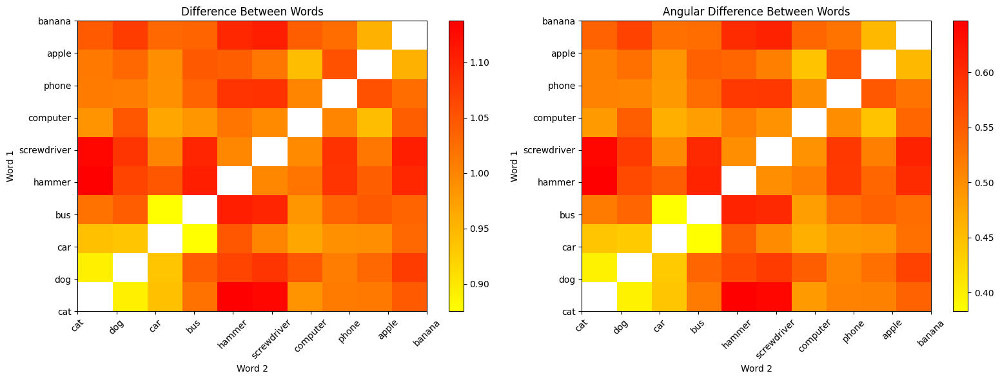

In [10]:
word1_list = ["cat", "dog", "car", "bus", "hammer", "screwdriver", "computer", "phone", "apple", "banana"]
word2_list = ["cat", "dog", "car", "bus", "hammer", "screwdriver", "computer", "phone", "apple", "banana"]

word1_embeds = [get_vector(model, word) for word in word1_list]
word2_embeds = [get_vector(model, word) for word in word2_list]

differences = np.zeros((len(word1_list), len(word2_list)))
angular_differences = np.zeros((len(word1_list), len(word2_list)))

for i, word1 in enumerate(word1_list):
    for j, word2 in enumerate(word2_list):
        differences[i][j] = get_difference(word1_embeds[i], word2_embeds[j])
        angular_differences[i][j] = get_angular_difference(word1_embeds[i], word2_embeds[j])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

hist1 = ax1.hist2d(
    np.repeat(range(len(word2_list)), len(word1_list)),
    np.tile(range(len(word1_list)), len(word2_list)),
    bins=(len(word2_list), len(word1_list)),
    weights=differences.flatten(),
    cmap='autumn_r',
    cmin=0.3
)
ax1.set_title('Difference Between Words')
ax1.set_xticks(range(len(word2_list)))
ax1.set_xticklabels(word2_list, rotation=45)
ax1.set_yticks(range(len(word1_list)))
ax1.set_yticklabels(word1_list)
ax1.set_xlabel('Word 2')
ax1.set_ylabel('Word 1')
plt.colorbar(hist1[3], ax=ax1)

hist2 = ax2.hist2d(
    np.repeat(range(len(word2_list)), len(word1_list)),
    np.tile(range(len(word1_list)), len(word2_list)),
    bins=(len(word2_list), len(word1_list)),
    weights=angular_differences.flatten(),
    cmap='autumn_r',
    cmin=0.3
)
ax2.set_title('Angular Difference Between Words')
ax2.set_xticks(range(len(word2_list)))
ax2.set_xticklabels(word2_list, rotation=45)
ax2.set_yticks(range(len(word1_list)))
ax2.set_yticklabels(word1_list)
ax2.set_xlabel('Word 2')
ax2.set_ylabel('Word 1')
plt.colorbar(hist2[3], ax=ax2)

plt.tight_layout()
plt.show()

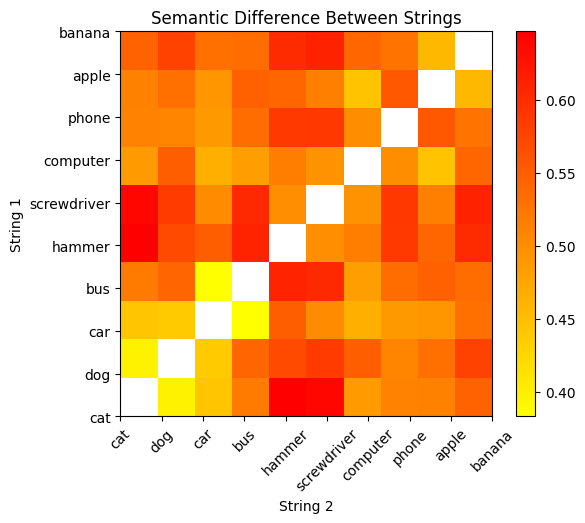

In [34]:
word1_list = ["cat", "dog", "car", "bus", "hammer", "screwdriver", "computer", "phone", "apple", "banana"]
word2_list = ["cat", "dog", "car", "bus", "hammer", "screwdriver", "computer", "phone", "apple", "banana"]
plot_word_differences(word1_list, word2_list, func=get_angular_difference)

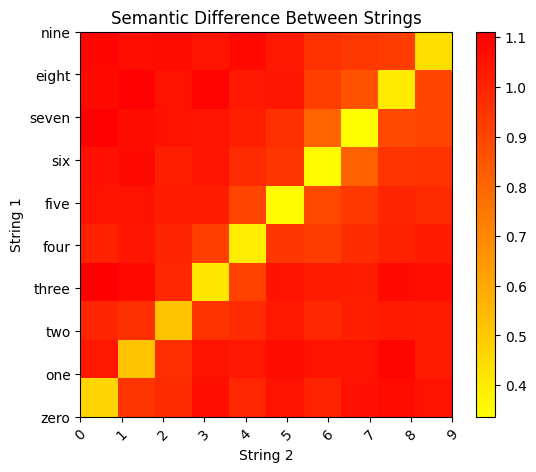

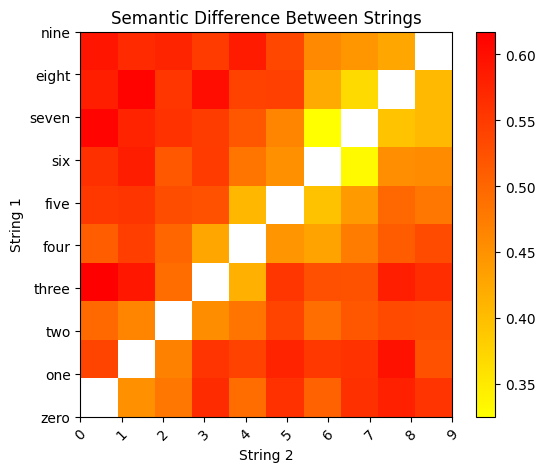

In [35]:
word1_list = ["zero", "one", "two", "three", "four", "five", "six", "seven", "eight", "nine"]
word2_list = [str(i) for i in range(10)]
plot_word_differences(word1_list, word2_list, func=get_difference)
plot_word_differences(word1_list, word2_list, func=get_angular_difference)


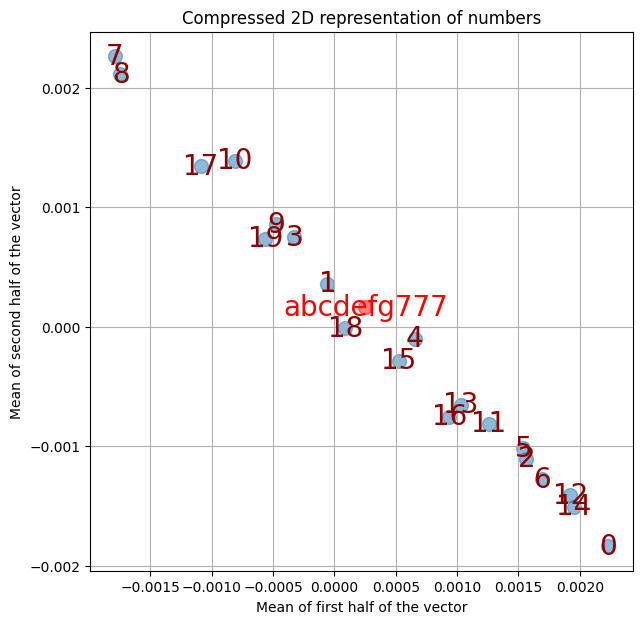

In [15]:
numbers = [str(i) for i in range(20)]
vectors = [get_vector(model, n) for n in numbers]
compressed_vectors = [compress_to_2d(v) for v in vectors]

test_string = "abcdefg777"
test_vector = get_vector(model, test_string)
test_compressed_vector = compress_to_2d(test_vector)

plt.figure(figsize=(7, 7))
plt.scatter(
    [v[0] for v in compressed_vectors],
    [v[1] for v in compressed_vectors],
    s=100,
    alpha=0.5,
)
plt.scatter(test_compressed_vector[0], test_compressed_vector[1], s=100, c="red", alpha=0.5)
for i, n in enumerate(numbers):
    plt.annotate(n, (compressed_vectors[i][0], compressed_vectors[i][1]), fontsize=20, ha='center', va='center', color="darkred")
plt.annotate(test_string, (test_compressed_vector[0], test_compressed_vector[1]), fontsize=20, ha='center', va='center', color="red")
plt.title("Compressed 2D representation of numbers")
plt.xlabel("Mean of first half of the vector")
plt.ylabel("Mean of second half of the vector")
plt.grid()
plt.show()


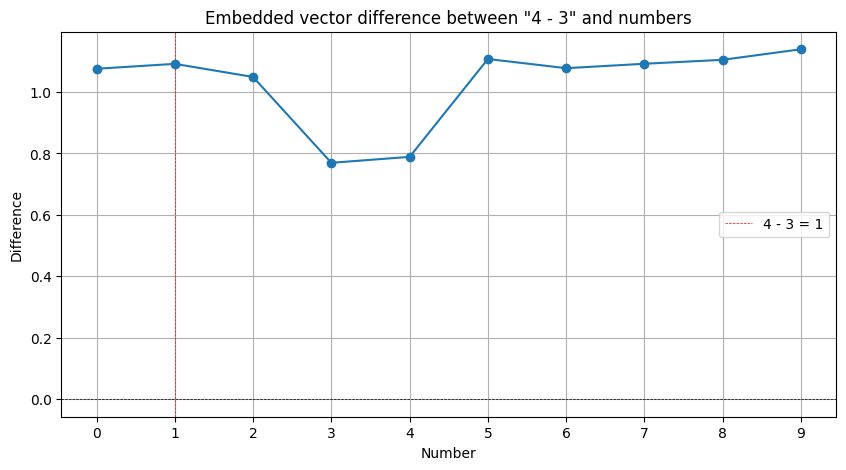

In [16]:
model = 'nomic-embed-text:latest'
addition = "4 - 3"

number_embeddings = []

for i in range(0, max(10, eval(addition) * 2)):
    number_embeddings.append(get_vector(model, str(i)))

addition_embedding = get_vector(model, addition)

plt.figure(figsize=(10, 5))
plt.title(f'Embedded vector difference between "{addition}" and numbers')
plt.xlabel("Number")
plt.ylabel("Difference")
plt.xticks(range(len(number_embeddings)), range(len(number_embeddings)))
plt.grid()
plt.axhline(0, color='black', lw=0.5, ls='--')
plt.axvline(int(eval(addition)), color='red', lw=0.5, ls='--', label=addition + " = " + str(int(eval(addition))))
plt.legend()
plt.plot(
    range(len(number_embeddings)),
    [get_difference(np.array(x).flatten(), addition_embedding) for x in number_embeddings],
    marker='o',
    label='Difference',
)
plt.show()


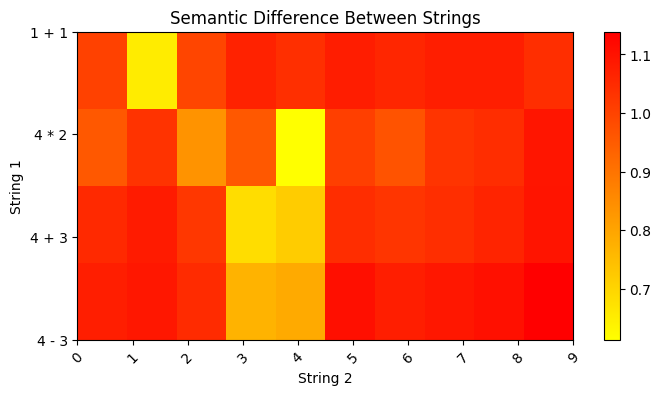

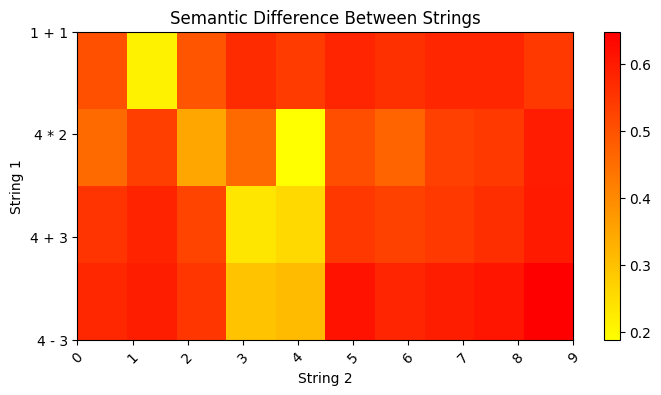

In [18]:
word1_list = ["4 - 3", "4 + 3", "4 * 2", "1 + 1"]
word2_list = [str(i) for i in range(10)]
plot_word_differences(word1_list, word2_list, figsize=(8, 4), cmap='autumn_r', cmin=0.3, func=get_difference)
plot_word_differences(word1_list, word2_list, figsize=(8, 4), cmap='autumn_r', cmin=0.0, func=get_angular_difference)

king_queen_difference: 0.26006679683054057
womanized_king_queen_difference: 0.18134091836589594

man_woman_difference: 0.311044236201072
queenified_man_woman_difference: 0.22595314212604534


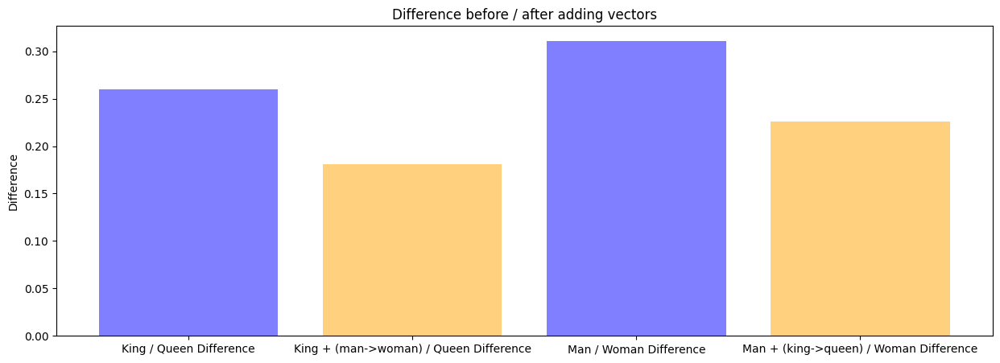

In [20]:
king_embedding = get_vector(model, "king")
queen_embedding = get_vector(model, "queen")

man_embedding = get_vector(model, "man")
woman_embedding = get_vector(model, "woman")

king_queen_difference = get_angular_difference(king_embedding, queen_embedding)
man_woman_difference = get_angular_difference(man_embedding, woman_embedding)

king_to_queen_vector = queen_embedding - king_embedding
man_to_woman_vector = woman_embedding - man_embedding

womanized_king_vector = king_embedding + man_to_woman_vector * 0.5
queenified_man_vector = man_embedding + king_to_queen_vector * 0.5

womanized_king_queen_difference = get_angular_difference(womanized_king_vector, queen_embedding)
queenified_man_woman_difference = get_angular_difference(queenified_man_vector, woman_embedding)


print(f"king_queen_difference: {king_queen_difference}")
print(f"womanized_king_queen_difference: {womanized_king_queen_difference}")
print()
print(f"man_woman_difference: {man_woman_difference}")
print(f"queenified_man_woman_difference: {queenified_man_woman_difference}")

plt.figure(figsize=(15, 5))
plt.bar(
    [
        "King / Queen Difference", "King + (man->woman) / Queen Difference",
        "Man / Woman Difference", "Man + (king->queen) / Woman Difference"
     ],
    [king_queen_difference, womanized_king_queen_difference, man_woman_difference, queenified_man_woman_difference],
    color=["blue", "orange"],
    alpha=0.5
)
plt.ylabel("Difference")
plt.title("Difference before / after adding vectors")
plt.show()

Optimal RATE: 0.5656565656565657
Lowest womanized_king_queen_difference: 0.18026002846029887

king_queen_difference: 0.26006679683054057
womanized_king_queen_difference: 0.18026002846029887

man_woman_difference: 0.311044236201072
queenified_man_woman_difference: 0.22230948003111883


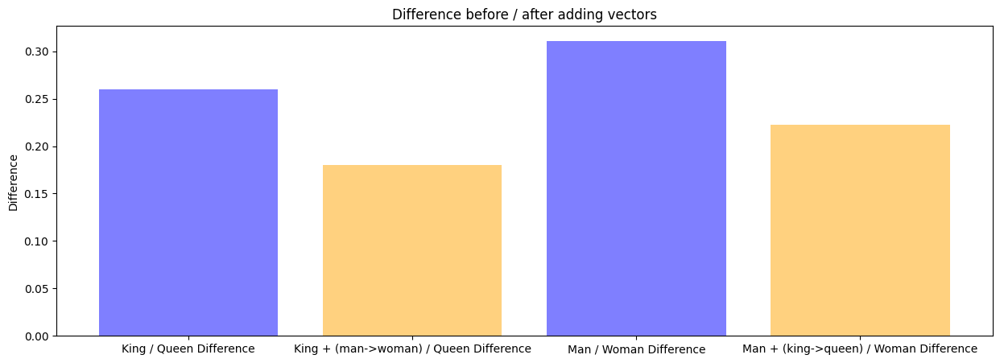

In [22]:
best_rate = None
lowest_difference = float('inf')

for rate in np.linspace(0, 1, 100):  # Test RATE values between 0 and 1 with 100 steps
    womanized_king_vector = king_embedding + man_to_woman_vector * rate
    womanized_king_queen_difference = get_angular_difference(womanized_king_vector, queen_embedding)
    
    if womanized_king_queen_difference < lowest_difference:
        lowest_difference = womanized_king_queen_difference
        best_rate = rate

print(f"Optimal RATE: {best_rate}")
print(f"Lowest womanized_king_queen_difference: {lowest_difference}")
print()

king_embedding = get_vector(model, "king")
queen_embedding = get_vector(model, "queen")

man_embedding = get_vector(model, "man")
woman_embedding = get_vector(model, "woman")

king_queen_difference = get_angular_difference(king_embedding, queen_embedding)
man_woman_difference = get_angular_difference(man_embedding, woman_embedding)

king_to_queen_vector = queen_embedding - king_embedding
man_to_woman_vector = woman_embedding - man_embedding

womanized_king_vector = king_embedding + man_to_woman_vector * best_rate
queenified_man_vector = man_embedding + king_to_queen_vector * best_rate

womanized_king_queen_difference = get_angular_difference(womanized_king_vector, queen_embedding)
queenified_man_woman_difference = get_angular_difference(queenified_man_vector, woman_embedding)


print(f"king_queen_difference: {king_queen_difference}")
print(f"womanized_king_queen_difference: {womanized_king_queen_difference}")
print()
print(f"man_woman_difference: {man_woman_difference}")
print(f"queenified_man_woman_difference: {queenified_man_woman_difference}")

plt.figure(figsize=(15, 5))
plt.bar(
    [
        "King / Queen Difference", "King + (man->woman) / Queen Difference",
        "Man / Woman Difference", "Man + (king->queen) / Woman Difference"
     ],
    [king_queen_difference, womanized_king_queen_difference, man_woman_difference, queenified_man_woman_difference],
    color=["blue", "orange"],
    alpha=0.5
)
plt.ylabel("Difference")
plt.title("Difference before / after adding vectors")
plt.show()

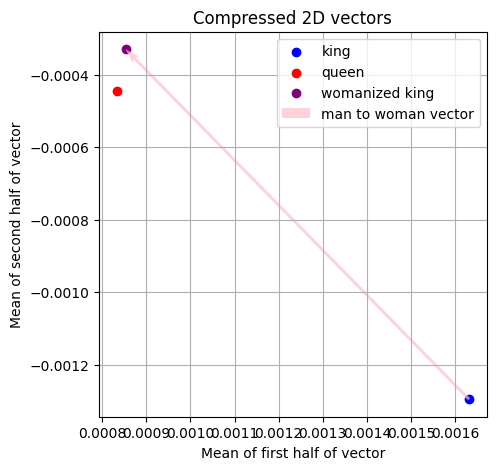

In [27]:
king_embedding = get_vector(model, "king")
queen_embedding = get_vector(model, "queen")

king_2d = compress_to_2d(king_embedding)
queen_2d = compress_to_2d(queen_embedding)

man_embedding = get_vector(model, "man")
woman_embedding = get_vector(model, "woman")

king_queen_difference = get_difference(king_embedding, queen_embedding)
man_woman_difference = get_difference(man_embedding, woman_embedding)

king_to_queen_vector = queen_embedding - king_embedding
man_to_woman_vector = woman_embedding - man_embedding

mtw_2d = compress_to_2d(man_to_woman_vector)

womanized_king_vector = king_embedding + man_to_woman_vector
womanized_man_vector = man_embedding + king_to_queen_vector

womanized_king_2d = compress_to_2d(womanized_king_vector)
womanized_man_2d = compress_to_2d(womanized_man_vector)

plt.figure(figsize=(5, 5))
plt.title('Compressed 2D vectors')
plt.xlabel("Mean of first half of vector")
plt.ylabel("Mean of second half of vector")
plt.grid()
plt.scatter(king_2d[0], king_2d[1], color='blue', label='king')
plt.scatter(queen_2d[0], queen_2d[1], color='red', label='queen')
plt.scatter(womanized_king_2d[0], womanized_king_2d[1], color='purple', label='womanized king')
plt.quiver(king_2d[0], king_2d[1], mtw_2d[0], mtw_2d[1], angles='xy', scale_units='xy', scale=1, color='pink', label='man to woman vector', alpha=0.7)
plt.legend()
plt.show()

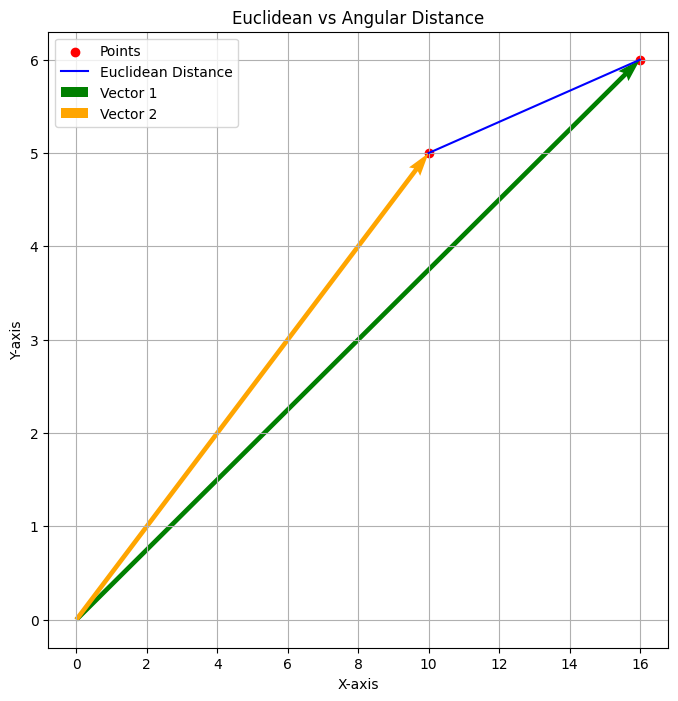

In [33]:
# Do a matplotlib demonstration of the difference between euclidian and angular distance as a concept
# between two vectors
# plot the two points in 2D space, and the euclidian distance between them
# and the angular distance between them

def plot_euclidean_vs_angular_distance(v1, v2, num_points=100):
    # Create a grid of points between the two vectors
    x = np.linspace(v1[0], v2[0], num_points)
    y = np.linspace(v1[1], v2[1], num_points)

    # Calculate the euclidean distance
    euclidean_distance = np.linalg.norm(np.array(v1) - np.array(v2))

    # Calculate the angular distance
    angular_distance = 1 - np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2))

    plt.figure(figsize=(8, 8))
    plt.title('Euclidean vs Angular Distance')
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.grid()

    # Plot the two points
    plt.scatter([v1[0], v2[0]], [v1[1], v2[1]], color='red', label='Points')
    
    # Plot the euclidean distance line
    plt.plot([v1[0], v2[0]], [v1[1], v2[1]], color='blue', label='Euclidean Distance')

    # Plot the angular distance line
    # Draw two lines from 0,0 to each point, then show the angle between them at 0, 0
    plt.quiver(0, 0, v1[0], v1[1], angles='xy', scale_units='xy', scale=1, color='green', label='Vector 1')
    plt.quiver(0, 0, v2[0], v2[1], angles='xy', scale_units='xy', scale=1, color='orange', label='Vector 2')


    plt.legend()
    plt.show()


plot_euclidean_vs_angular_distance([16, 6], [10, 5])

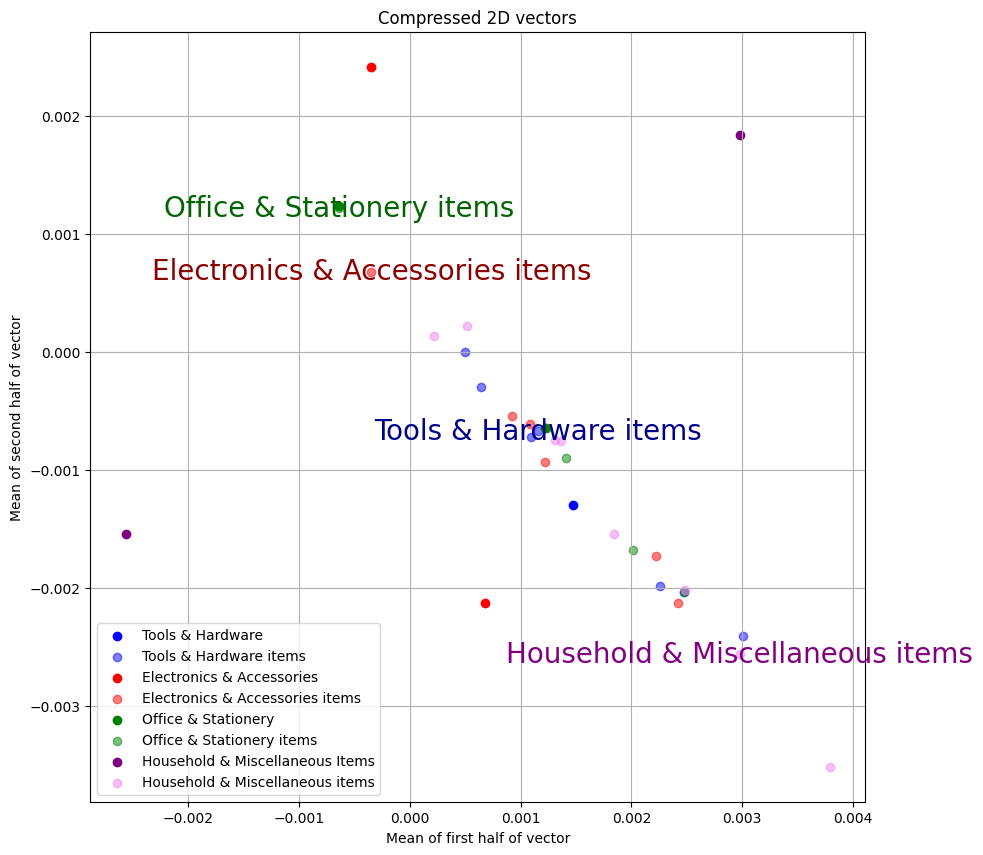

In [105]:
tools = "Tools & Hardware"
tool_embedding = get_vector(model, tools)
tool_2d = compress_to_2d(tool_embedding)
tools_list = ["Allen keys", "Drill", "Screwdriver", "Cleaning foam", "Metal bar", "Steel wool", "Stapler"]
tools_embeddings = [get_vector(model, t) for t in tools_list]
tools_2d = [compress_to_2d(t) for t in tools_embeddings]

electronics = "Electronics & Accessories"
electronics_embedding = get_vector(model, electronics)
electronics_2d = compress_to_2d(electronics_embedding)
electronics_list = ["PC fan", "Black PCIe", "Headphones", "Xbox 360 controller", "Wired mouse", "Power cords"]
electronics_embeddings = [get_vector(model, e) for e in electronics_list]
electronics_2d = [compress_to_2d(e) for e in electronics_embeddings]

office = "Office & Stationery"
office_embedding = get_vector(model, office)
office_2d = compress_to_2d(office_embedding)
office_list = ["Tippex", "Empty paper plate", "Empty biscuit box", "Stapler", "Plastic bag"]
office_embeddings = [get_vector(model, o) for o in office_list]
office_2d = [compress_to_2d(o) for o in office_embeddings]

household = "Household & Miscellaneous Items"
household_embedding = get_vector(model, household)
household_2d = compress_to_2d(household_embedding)
household_list = ["Black mug", "Yellow and white gloves", "Sponge", "Tape", "Gray gloves", "Soap", "Gray sponge", "Cloth 1"]
household_embeddings = [get_vector(model, h) for h in household_list]
household_2d = [compress_to_2d(h) for h in household_embeddings]


plt.figure(figsize=(10, 10))
plt.title('Compressed 2D vectors')
plt.xlabel("Mean of first half of vector")
plt.ylabel("Mean of second half of vector")
plt.grid()

plt.scatter(tool_2d[0], tool_2d[1], color='blue', label=tools)
plt.scatter([t[0] for t in tools_2d], [t[1] for t in tools_2d], color='blue', alpha=0.5, label="Tools & Hardware items")
plt.scatter(electronics_2d[0], electronics_2d[1], color='red', label=electronics)
plt.scatter([e[0] for e in electronics_2d], [e[1] for e in electronics_2d], color='red', alpha=0.5, label="Electronics & Accessories items")
plt.scatter(office_2d[0], office_2d[1], color='green', label=office)
plt.scatter([o[0] for o in office_2d], [o[1] for o in office_2d], color='green', alpha=0.5, label="Office & Stationery items")
plt.scatter(household_2d[0], household_2d[1], color='purple', label=household)
plt.scatter([h[0] for h in household_2d], [h[1] for h in household_2d], color='violet', alpha=0.5, label="Household & Miscellaneous items")

plt.annotate("Tools & Hardware items", (tools_2d[0][0], tools_2d[0][1]), fontsize=20, ha='center', va='center', color="darkblue")
plt.annotate("Electronics & Accessories items", (electronics_2d[0][0], electronics_2d[0][1]), fontsize=20, ha='center', va='center', color="darkred")
plt.annotate("Office & Stationery items", (office_2d[0][0], office_2d[0][1]), fontsize=20, ha='center', va='center', color="darkgreen")
plt.annotate("Household & Miscellaneous items", (household_2d[0][0], household_2d[0][1]), fontsize=20, ha='center', va='center', color="purple")

plt.legend()
plt.show()

In [4]:
def analyze_word_and_description(word, word_description):
    hammer_embedding = get_vector(model, word)
    hammer_2d = compress_to_2d(hammer_embedding)

    hammer_desc = word_description.split()
    hammer_desc_embeddings = [get_vector(model, " ".join(hammer_desc[0:i+1])) for i in range(0, len(hammer_desc))]
    hammer_desc_2d = [compress_to_2d(h) for h in hammer_desc_embeddings]

    plt.figure(figsize=(15, 10))
    plt.title('Compressed 2D vectors')
    plt.xlabel("Mean of first half of vector")
    plt.ylabel("Mean of second half of vector")
    plt.grid()
    plt.axhline(0, color='black', lw=2)
    plt.axvline(0, color='black', lw=2)
    plt.scatter(hammer_2d[0], hammer_2d[1], color='red', label=word)
    plt.annotate(word, (hammer_2d[0], hammer_2d[1]), fontsize=20, ha='left', va='top', color="red")

    for i, d in enumerate(hammer_desc_2d):
        color = (i / len(hammer_desc), 0, 1 - i / len(hammer_desc))
        if i != 0 and i != len(hammer_desc) - 1:
            plt.scatter(d[0], d[1], color=color, alpha=0.5, label=" ".join(hammer_desc[0:i+1]))
        else:
            plt.scatter(d[0], d[1], color=color, alpha=0.5, label=" ".join(hammer_desc[0:i+1]), marker='x', s=100)

    plt.legend()
    plt.show()

    # Plot the difference between the word and the word description embeddings, as more words get added
    plt.figure(figsize=(10, 5))
    plt.title('Difference between Word and Word Description')
    plt.xlabel("Number of words in description")
    plt.ylabel("Difference")
    plt.xticks(range(len(hammer_desc)), range(len(hammer_desc)))
    plt.grid()
    plt.axhline(0, color='black', lw=0.5)
    plt.plot(
        range(len(hammer_desc)),
        [get_difference(np.array(x).flatten(), hammer_embedding) for x in hammer_desc_embeddings],
        marker='o',
        label='Difference',
    )
    plt.show()

def analyze_word_and_wordlist(word, alternative_words, figsize=(15, 10)):
    hammer_embedding = get_vector(model, word)
    hammer_2d = compress_to_2d(hammer_embedding)

    hammer_desc = alternative_words
    hammer_desc_embeddings = [get_vector(model, w) for w in hammer_desc]
    hammer_desc_2d = [compress_to_2d(h) for h in hammer_desc_embeddings]

    differences = [get_difference(hammer_embedding, h) for h in hammer_desc_embeddings]
    min_diff = min(differences)
    max_diff = max(differences)
    diff_range = max_diff - min_diff

    plt.figure(figsize=figsize)
    plt.title('Compressed 2D vectors')
    plt.xlabel("Mean of first half of vector")
    plt.ylabel("Mean of second half of vector")
    plt.grid()
    plt.axhline(0, color='black', lw=2)
    plt.axvline(0, color='black', lw=2)
    plt.scatter(hammer_2d[0], hammer_2d[1], color='red', label=word)
    plt.annotate(word, (hammer_2d[0], hammer_2d[1]), fontsize=20, ha='left', va='top', color="red")

    for i, d in enumerate(hammer_desc_2d):
        diff = differences[i]
        color = (1 - ((diff - 0.3) / 1.2), 0, (diff - 0.3) / 1.2)
        plt.scatter(d[0], d[1], color=color, alpha=0.5, label=hammer_desc[i] + f"(Diff: {diff:.2f})", marker='x', s=100)
        plt.annotate(hammer_desc[i], (d[0], d[1]), fontsize=10, ha='center', va='top', color=color)


    plt.legend()
    plt.show()

    #colors = [(1, 1 - (diff - min_diff) / diff_range, 0) for diff in differences]
    colors = plt.cm.RdYlGn_r((np.array(differences) - min_diff) / diff_range)

    plt.figure(figsize=(10, 5))
    plt.title(f'Difference between "{word}" and Alternative Words')
    plt.xlabel("Alternative Word")
    plt.ylabel("Difference")
    plt.ylim(0.3, 1.2)
    plt.xticks(range(len(hammer_desc)), hammer_desc, rotation=30)
    plt.bar(
        range(len(hammer_desc)),
        differences,
        color=colors,
        label='Difference',
        edgecolor="black",
        linewidth=0.5,
    )
    plt.show()

In [5]:
def analyze_word_and_wordlist(word, alternative_words, figsize=(15, 10)):
    hammer_embedding = get_vector(model, word)
    hammer_2d = compress_to_2d(hammer_embedding)

    hammer_desc = alternative_words
    hammer_desc_embeddings = [get_vector(model, w) for w in hammer_desc]
    hammer_desc_2d = [compress_to_2d(h) for h in hammer_desc_embeddings]

    differences = [get_difference(hammer_embedding, h) for h in hammer_desc_embeddings]
    min_diff = min(differences)
    max_diff = max(differences)
    diff_range = max_diff - min_diff

    plt.figure(figsize=figsize)
    plt.title('Sıkıştırılmış iki boyutlu vektörler') 
    plt.xlabel("Vektörün ilk yarısının ortalaması") 
    plt.ylabel("Vektörün ikinci yarısının ortalaması") 
    plt.grid()
    plt.axhline(0, color='black', lw=2)
    plt.axvline(0, color='black', lw=2)
    plt.scatter(hammer_2d[0], hammer_2d[1], color='red', label=word)
    plt.annotate(word, (hammer_2d[0], hammer_2d[1]), fontsize=20, ha='left', va='top', color="red")

    for i, d in enumerate(hammer_desc_2d):
        diff = differences[i]
        color = (1 - ((diff - 0.3) / 1.2), 0, (diff - 0.3) / 1.2)
        plt.scatter(d[0], d[1], color=color, alpha=0.5, label=hammer_desc[i] + f"(Diff: {diff:.2f})", marker='x', s=100)
        plt.annotate(hammer_desc[i], (d[0], d[1]), fontsize=10, ha='center', va='top', color=color)


    plt.legend()
    plt.show()

    colors = plt.cm.RdYlGn_r((np.array(differences) - min_diff) / diff_range)

    plt.figure(figsize=(10, 5))
    plt.title(f'"{word}" metni ve diğer metinler arasındaki fark') 
    plt.xlabel("Diğer Metin") 
    plt.ylabel("Fark") 
    plt.ylim(0.3, 1.2)
    plt.xticks(range(len(hammer_desc)), hammer_desc, rotation=10)
    plt.bar(
        range(len(hammer_desc)),
        differences,
        color=colors,
        label='Fark', 
        edgecolor="black",
        linewidth=0.5,
    )
    plt.show()
    return hammer_desc[np.argmin(differences)]

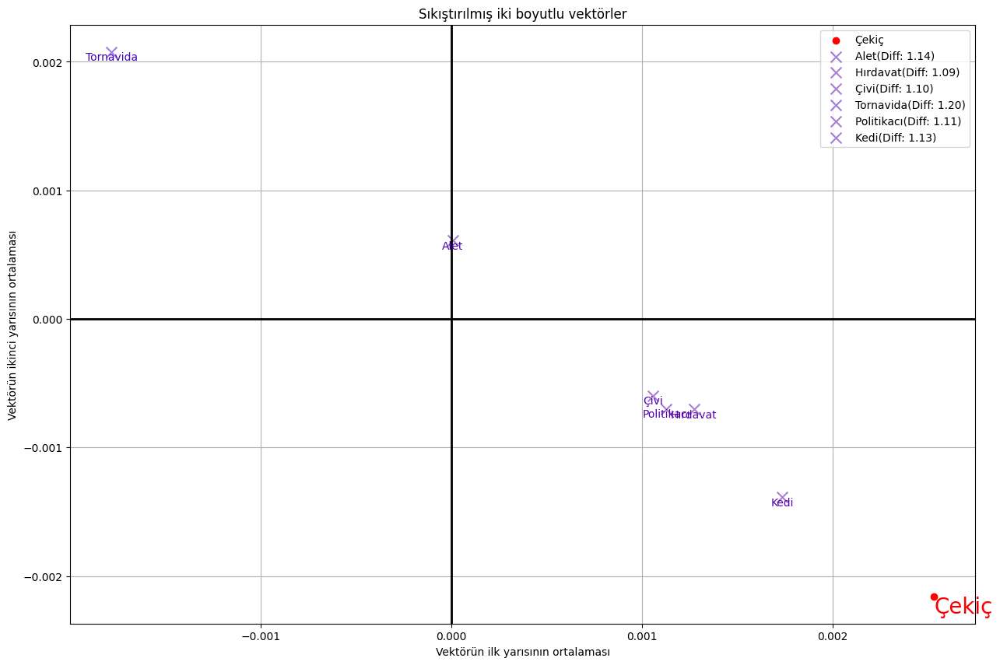

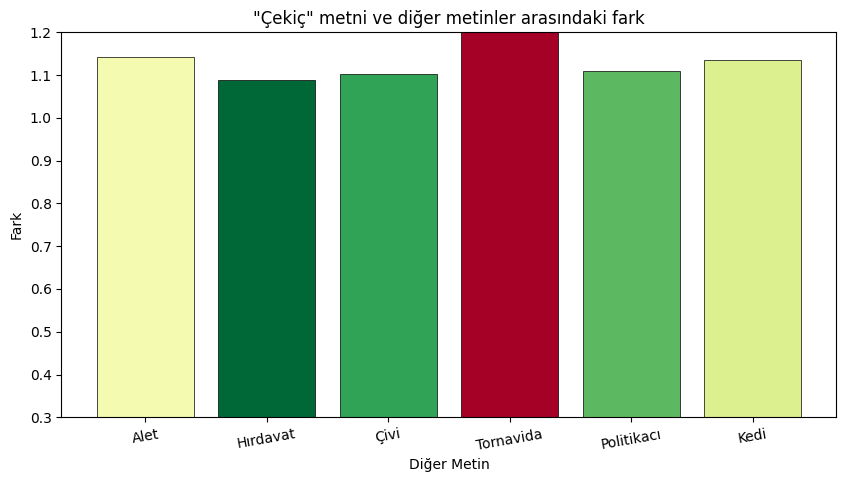

'Hırdavat'

In [120]:
wordlist = ["Alet", "Hırdavat", "Çivi", "Tornavida", "Politikacı", "Kedi"]
analyze_word_and_wordlist("Çekiç", wordlist)

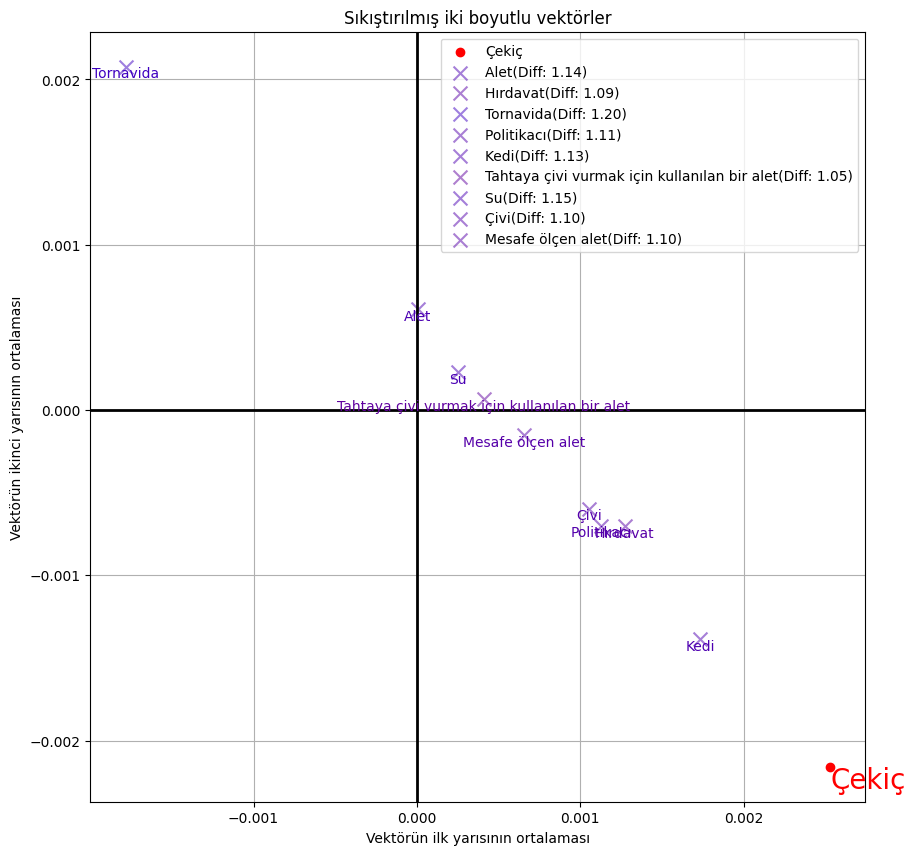

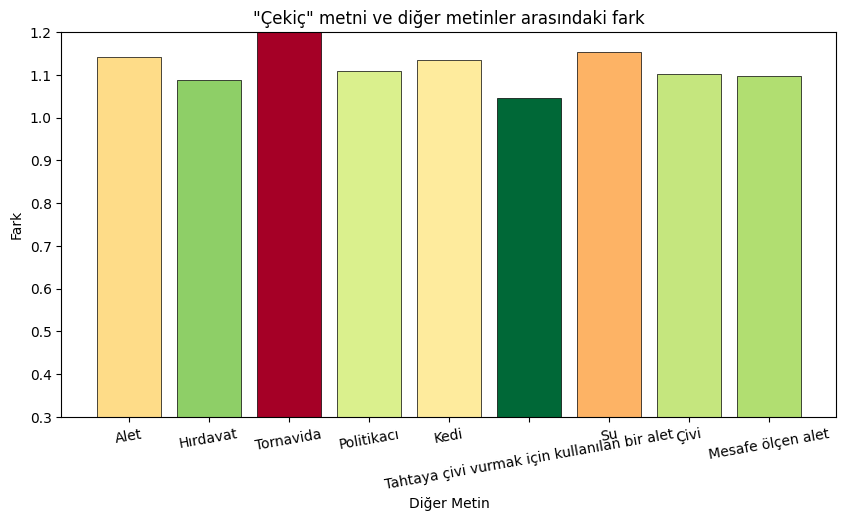

'Tahtaya çivi vurmak için kullanılan bir alet'

In [114]:
wordlist = ["Alet", "Hırdavat", "Tornavida", "Politikacı", "Kedi", "Tahtaya çivi vurmak için kullanılan bir alet", "Su", "Çivi", "Mesafe ölçen alet"]
analyze_word_and_wordlist("Çekiç", wordlist, figsize=(10, 10))

---

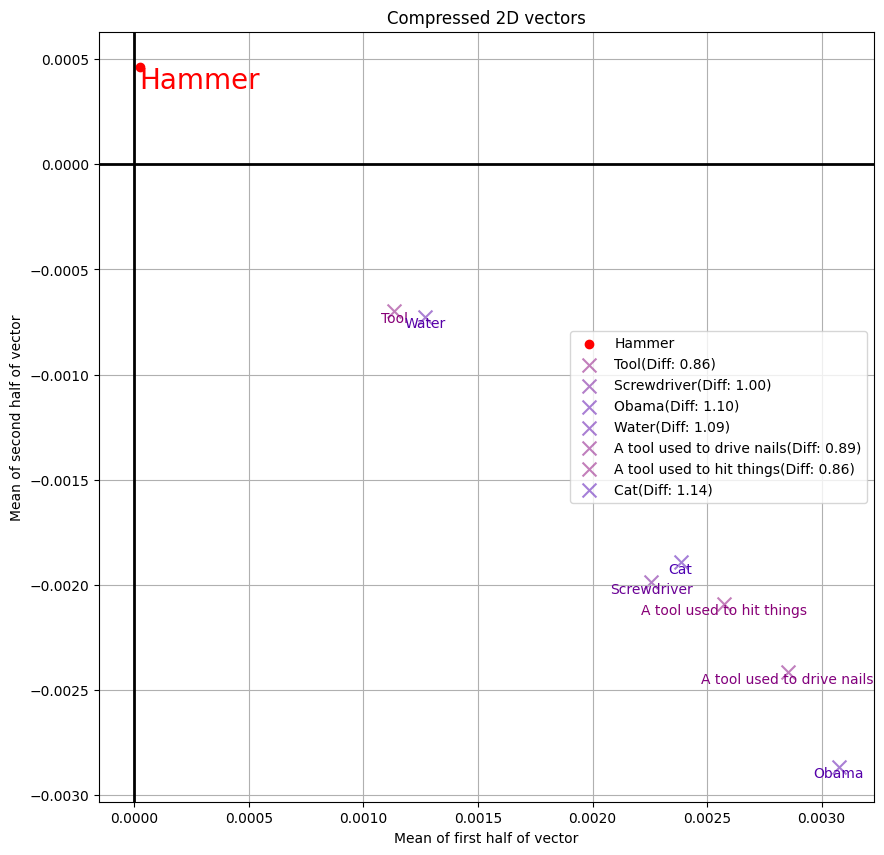

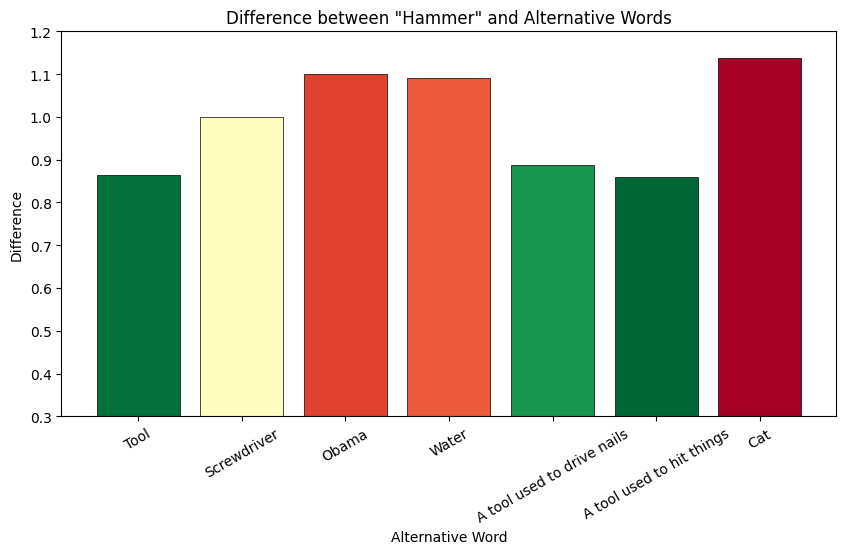

In [379]:
wordlist = ["Tool", "Screwdriver", "Obama", "Water", "A tool used to drive nails",
             "A tool used to hit things", "Cat"]
analyze_word_and_wordlist("Hammer", wordlist, figsize=(10, 10))

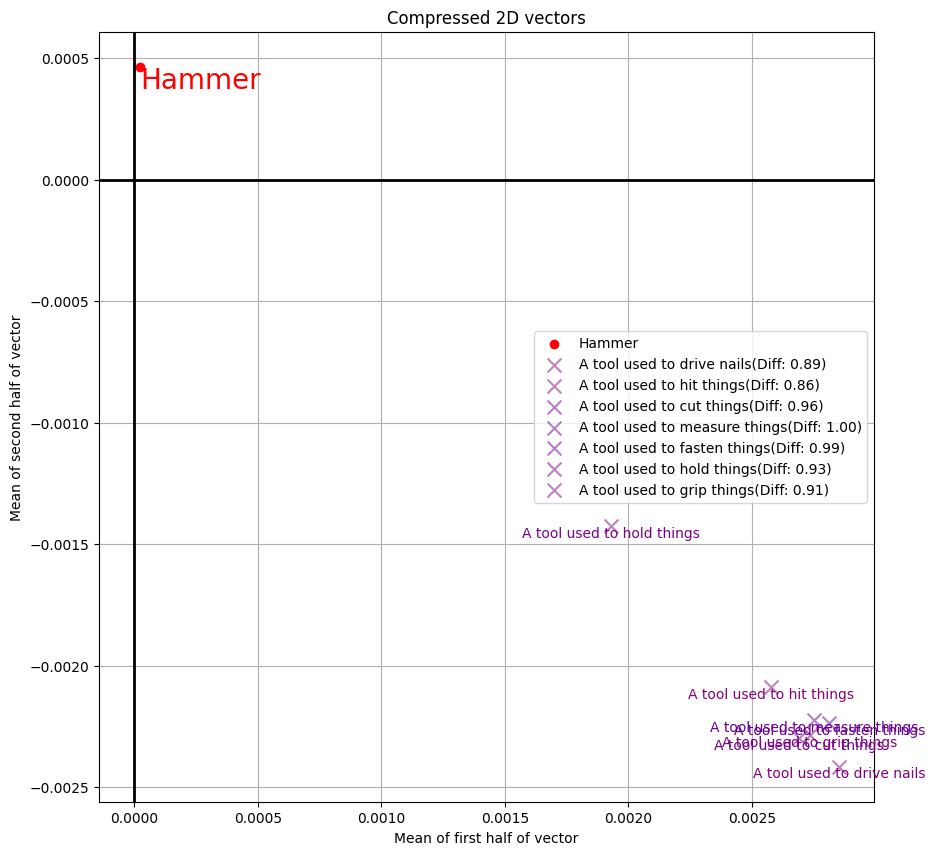

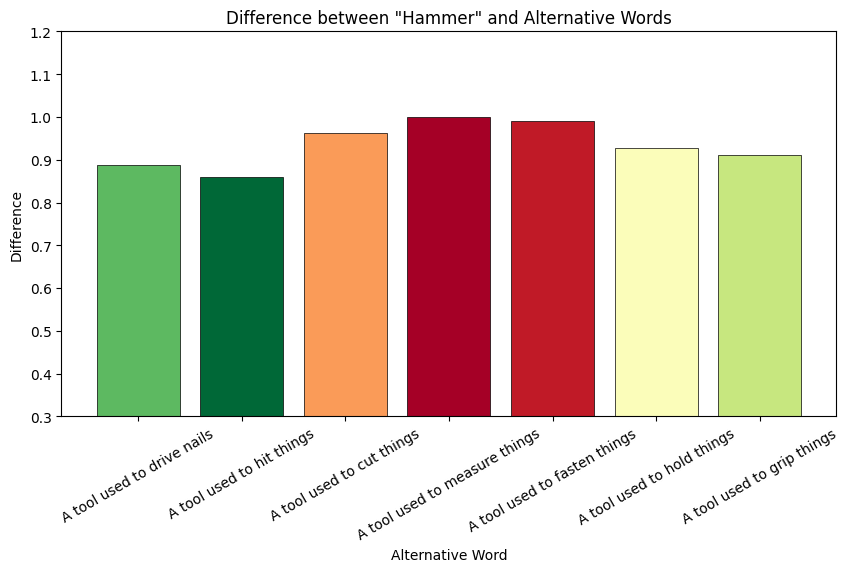

In [380]:
wordlist = ["A tool used to drive nails", "A tool used to hit things", "A tool used to cut things", "A tool used to measure things",
             "A tool used to fasten things", "A tool used to hold things", "A tool used to grip things"]
analyze_word_and_wordlist("Hammer", wordlist, figsize=(10, 10))

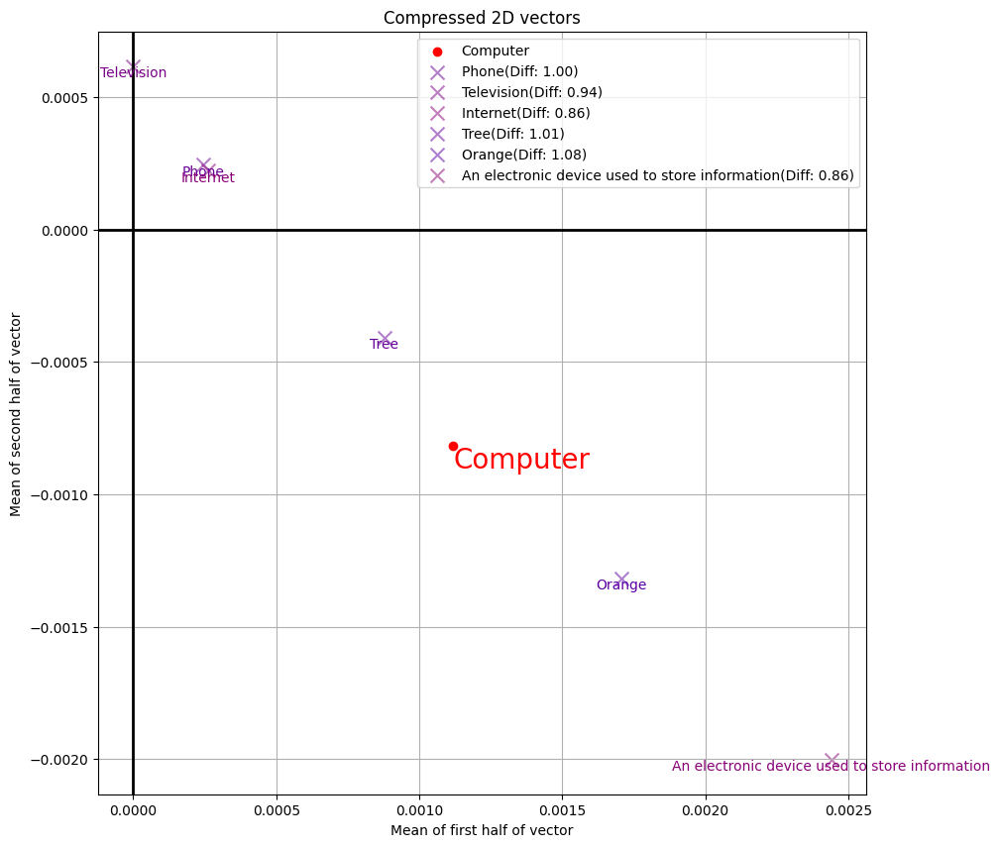

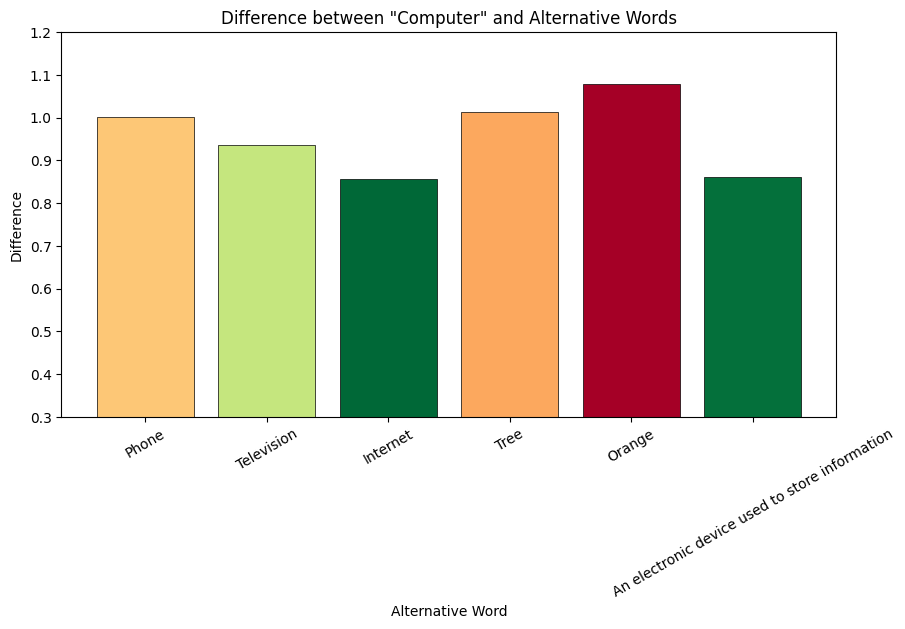

In [381]:
wordlist = ["Phone", "Television", "Internet", "Tree", "Orange", "An electronic device used to store information",]
analyze_word_and_wordlist("Computer", wordlist, figsize=(10, 10))

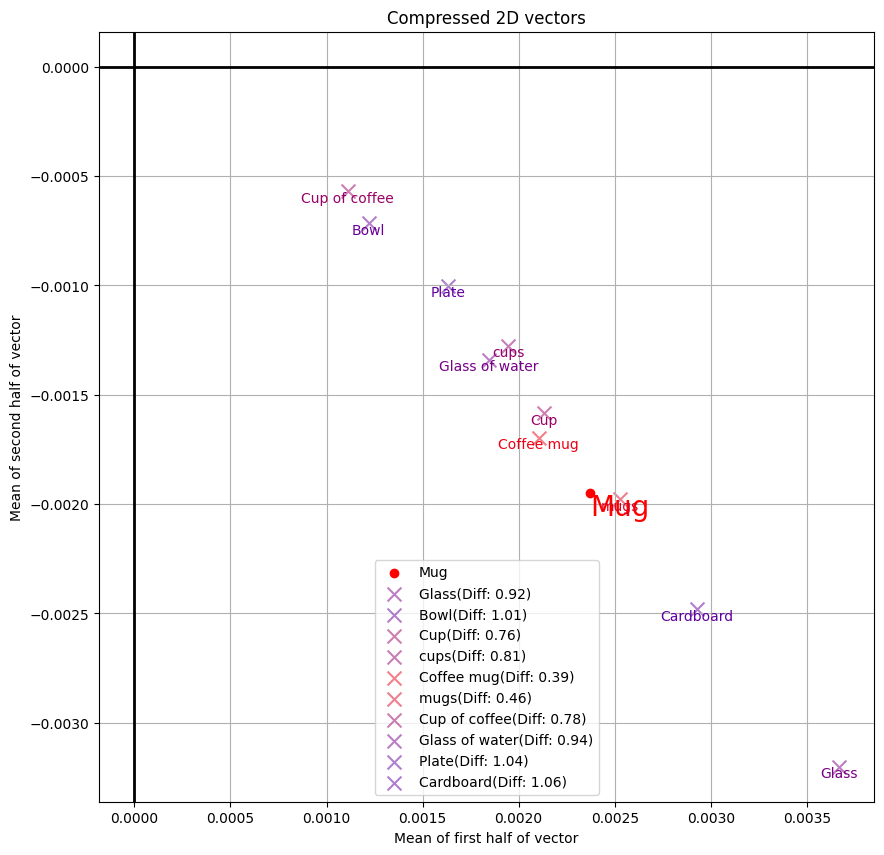

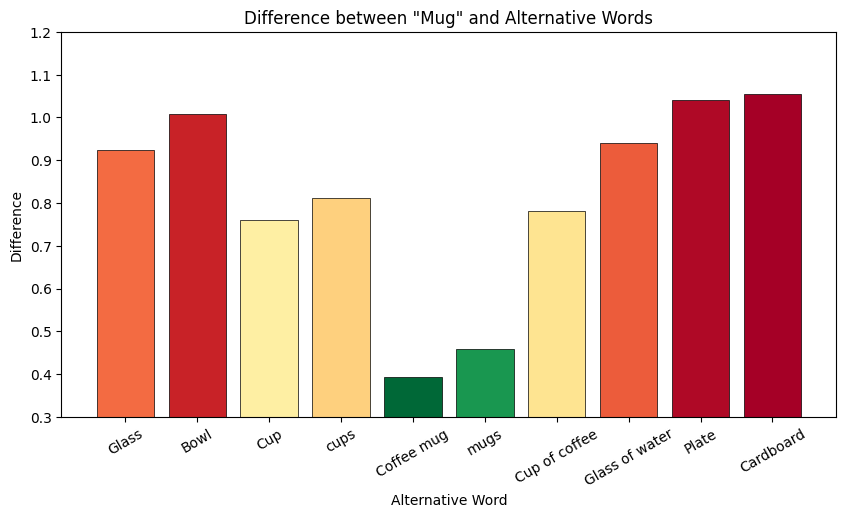

In [395]:
wordlist = ["Glass", "Bowl", "Cup", "cups", "Coffee mug", "mugs", "Cup of coffee", "Glass of water", "Plate", "Cardboard"]
analyze_word_and_wordlist("Mug", wordlist, figsize=(10, 10))

In [6]:
import pandas as pd 
import os

def read_csv(file_path):
    if os.path.exists(file_path):
        df = pd.read_csv(file_path)
        return df
    else:
        print(f"File {file_path} does not exist.")
        return None

In [ ]:
responses = read_csv("output/output/responses.csv")
responses

,prompt,model,image_folder,image_name,model_response,correct_object_names,success,response_time
0,What is the object in the image? Answer with a...,llava,images_base,01.jpg,Robot,mug; cup,False,1.892505
1,What is the object in the image? Answer with a...,llava,images_base,02.jpg,Robot,mug; cup,False,0.460591
2,What is the object in the image? Answer with a...,llava,images_base,03.jpg,Robot,mug; cup,False,0.459326
3,What is the object in the image? Answer with a...,llava,images_base,04.jpg,Robot,mug; cup,False,0.461429
4,What is the object in the image? Answer with a...,llava,images_base,05.jpg,Robot,sponge,False,0.461970
...,...,...,...,...,...,...,...,...
5275,Act as a robotic assistant that identifies too...,gemma3:27b,images_base,56.jpg,"Okay, analyzing the image...\n\nBased on my vi...",cloth; fabric; clothing,True,34.031404
5276,Act as a robotic assistant that identifies too...,gemma3:27b,images_base,57.jpg,Analyzing image...\n\nI have identified a **co...,mouse,True,18.250291
5277,Act as a robotic assistant that identifies too...,gemma3:27b,images_base,58.jpg,Analyzing image...\n\nI have identified the to...,screwdriver,True,23.185647
5278,Act as a robotic assistant that identifies too...,gemma3:27b,images_base,59.jpg,"Okay, analyzing... \n\nBased on my visual sens...",pcb; circuit board; pcie,False,43.286656


In [7]:
def get_correct_object_embeddings(df, embedding_model):
    correct_object_names = df["correct_object_names"].unique()
    correct_object_embeddings = {}
    for names in correct_object_names:
        temp = []
        for name in names.split(";"):
            temp.append(get_vector(embedding_model, name.strip()))
        correct_object_embeddings[names] = temp
    return correct_object_embeddings

def get_model_response_embeddings(df, embedding_model):
    model_responses = df["model_response"].unique()
    model_response_embeddings = {}
    for response in model_responses:
        model_response_embeddings[response] = get_vector(embedding_model, response)
    return model_response_embeddings

def update_responses_with_embeddings(df, correct_object_embeddings, model_response_embeddings):
    df["model_response_embedding"] = df["model_response"].apply(lambda x: model_response_embeddings[x])
    df["correct_object_embeddings"] = df["correct_object_names"].apply(lambda x: correct_object_embeddings[x])
    return df

    

In [75]:
correct_object_embeddings = get_correct_object_embeddings(responses, model)
model_response_embeddings = get_model_response_embeddings(responses, model)
responses_with_embeddings = update_responses_with_embeddings(responses, correct_object_embeddings, model_response_embeddings)

In [78]:
responses.head(2)

,prompt,model,image_folder,image_name,model_response,correct_object_names,success,response_time,model_response_embedding,correct_object_embeddings
0,What is the object in the image? Answer with a...,llava,images_base,01.jpg,Robot,mug; cup,False,1.892505,"[-0.0152445575, 0.043711785, -0.13146508, 0.01...","[[-0.05195549, 0.064917825, -0.15182155, -0.05..."
1,What is the object in the image? Answer with a...,llava,images_base,02.jpg,Robot,mug; cup,False,0.460591,"[-0.0152445575, 0.043711785, -0.13146508, 0.01...","[[-0.05195549, 0.064917825, -0.15182155, -0.05..."


In [101]:
def get_difference_for_model_in_row(model_name, i):
    row = responses[responses["model"] == model_name].iloc[i]
    min_difference = min([get_difference(row["model_response_embedding"], o) for o in responses["correct_object_embeddings"].iloc[0]])
    return float(min_difference)

def get_angular_difference_for_model_in_row(model_name, i):
    row = responses[responses["model"] == model_name].iloc[i]
    min_difference = min([get_angular_difference(row["model_response_embedding"], o) for o in responses["correct_object_embeddings"].iloc[0]])
    return float(min_difference)

def get_differences_in_row(df, i):
    row = df.iloc[i]
    min_difference = min([get_difference(row["model_response_embedding"], o) for o in row["correct_object_embeddings"]])
    min_angular_difference = min([get_angular_difference(row["model_response_embedding"], o) for o in row["correct_object_embeddings"]])
    return float(min_difference), float(min_angular_difference)

def update_responses_with_differences(df):
    df["difference"] = df.apply(lambda row: get_differences_in_row(df, row.name)[0], axis=1)
    df["angular_difference"] = df.apply(lambda row: get_differences_in_row(df, row.name)[1], axis=1)
    return df

In [109]:
responses_with_differences = update_responses_with_differences(responses)
responses_with_differences.head(2)

,prompt,model,image_folder,image_name,model_response,correct_object_names,success,response_time,model_response_embedding,correct_object_embeddings,difference,angular_difference
0,What is the object in the image? Answer with a...,llava,images_base,01.jpg,Robot,mug; cup,False,1.892505,"[-0.0152445575, 0.043711785, -0.13146508, 0.01...","[[-0.05195549, 0.064917825, -0.15182155, -0.05...",1.059456,0.561223
1,What is the object in the image? Answer with a...,llava,images_base,02.jpg,Robot,mug; cup,False,0.460591,"[-0.0152445575, 0.043711785, -0.13146508, 0.01...","[[-0.05195549, 0.064917825, -0.15182155, -0.05...",1.059456,0.561223


In [159]:
responses.to_csv("output/output/responses_with_difference.csv", index=False)

In [ ]:
responses = read_csv("output/output/responses_with_difference.csv")

In [8]:
responses = read_csv("output/responses_with_final_success.csv")

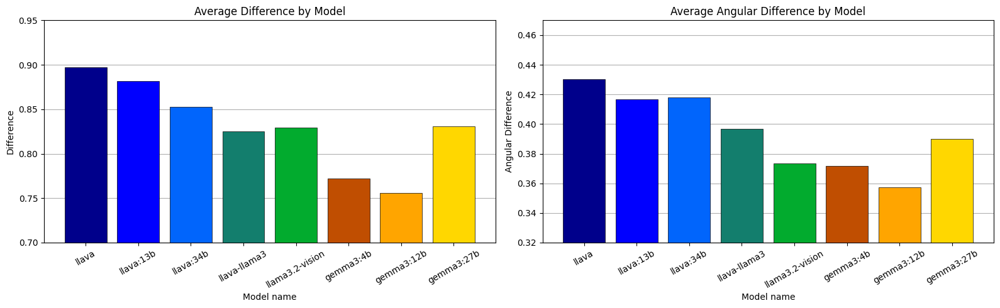

In [116]:
plt.figure(figsize=(16, 5))
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]

plt.subplot(1, 2, 1)
plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    plt.bar(
        model_name,
        responses[responses["model"] == model_name]["difference"].mean(),
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )

plt.ylim(0.7, 0.95)
plt.title("Average Difference by Model")
plt.xlabel("Model name")
plt.ylabel("Difference")
plt.xticks(rotation=30)

plt.subplot(1, 2, 2)
plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    plt.bar(
        model_name,
        responses[responses["model"] == model_name]["angular_difference"].mean(),
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )

plt.ylim(0.32, 0.47)
plt.title("Average Angular Difference by Model")
plt.xlabel("Model name")
plt.ylabel("Angular Difference")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()


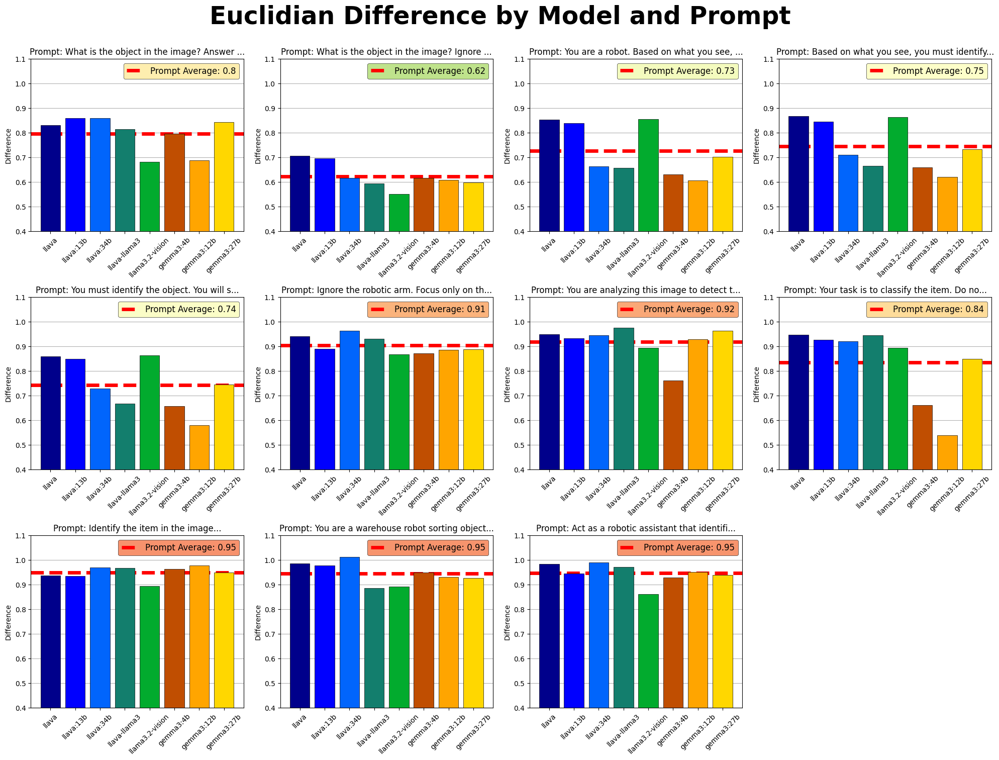

In [8]:
unique_prompts = responses["prompt"].unique()
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for idx, prompt in enumerate(unique_prompts[:12]):
    ax = axes[idx]
    ax.grid(axis="y")
    prompt_mean = 0
    for i, model_name in enumerate(responses["model"].unique()):
        differences = responses[(responses["prompt"] == prompt) & (responses["model"] == model_name)]["difference"]
        ax.bar(
            model_name,
            differences.mean(),
            #label=model_name,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,   
        )
        prompt_mean += differences.mean()
    prompt_mean = prompt_mean / len(responses["model"].unique())
    ax.axhline(prompt_mean, color='red', lw=5, ls='--', label="Prompt Average: " + str(round(prompt_mean, 2)))
    
    ax.set_ylim(0.4, 1.1)
    ax.set_xticks(range(len(responses["model"].unique())))
    ax.set_xticklabels(responses["model"].unique(), rotation=45)
    ax.set_title(f"Prompt: {prompt[:40]}...")
    ax.set_ylabel("Difference")
    legend = ax.legend(fontsize=12)
    legend.get_frame().set_facecolor(plt.cm.RdYlGn_r((prompt_mean - 0.4) / (1.1 - 0.4)))
    legend.get_frame().set_edgecolor("black")
    legend.get_frame().set_linewidth(0.5)


for idx in range(len(unique_prompts), len(axes)):
    fig.delaxes(axes[idx])

plt.suptitle("Euclidian Difference by Model and Prompt", fontsize=35, fontweight='bold', y=1.005)
plt.tight_layout()
plt.show()


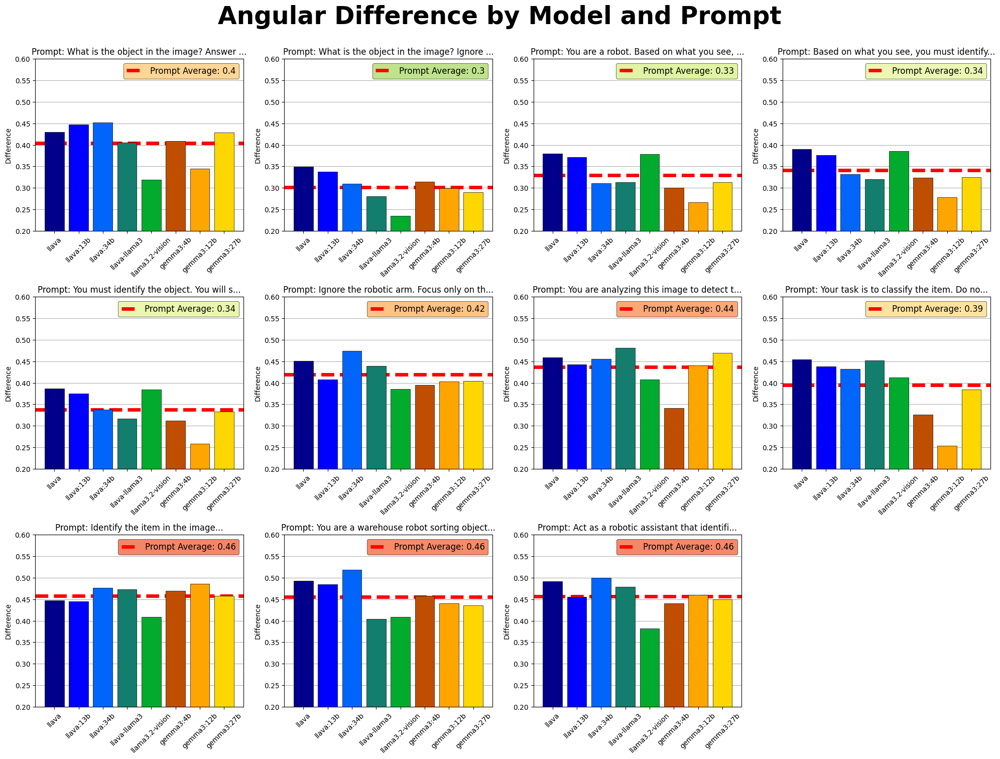

In [9]:
unique_prompts = responses["prompt"].unique()
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for idx, prompt in enumerate(unique_prompts[:12]):
    ax = axes[idx]
    ax.grid(axis="y")
    prompt_mean = 0
    for i, model_name in enumerate(responses["model"].unique()):
        differences = responses[(responses["prompt"] == prompt) & (responses["model"] == model_name)]["angular_difference"]
        ax.bar(
            model_name,
            differences.mean(),
            #label=model_name,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,   
        )
        prompt_mean += differences.mean()
    prompt_mean = prompt_mean / len(responses["model"].unique())
    ax.axhline(prompt_mean, color='red', lw=5, ls='--', label="Prompt Average: " + str(round(prompt_mean, 2)))
    
    ax.set_ylim(0.2, 0.6)
    ax.set_xticks(range(len(responses["model"].unique())))
    ax.set_xticklabels(responses["model"].unique(), rotation=45)
    ax.set_title(f"Prompt: {prompt[:40]}...")
    ax.set_ylabel("Difference")
    #ax.legend(fontsize=12)
    legend = ax.legend(fontsize=12)
    legend.get_frame().set_facecolor(plt.cm.RdYlGn_r((prompt_mean - 0.2) / (0.52 - 0.2)))
    legend.get_frame().set_edgecolor("black")
    legend.get_frame().set_linewidth(0.5)


for idx in range(len(unique_prompts), len(axes)):
    fig.delaxes(axes[idx])

plt.suptitle("Angular Difference by Model and Prompt", fontsize=35, fontweight='bold', y=1.005)
plt.tight_layout()
plt.show()

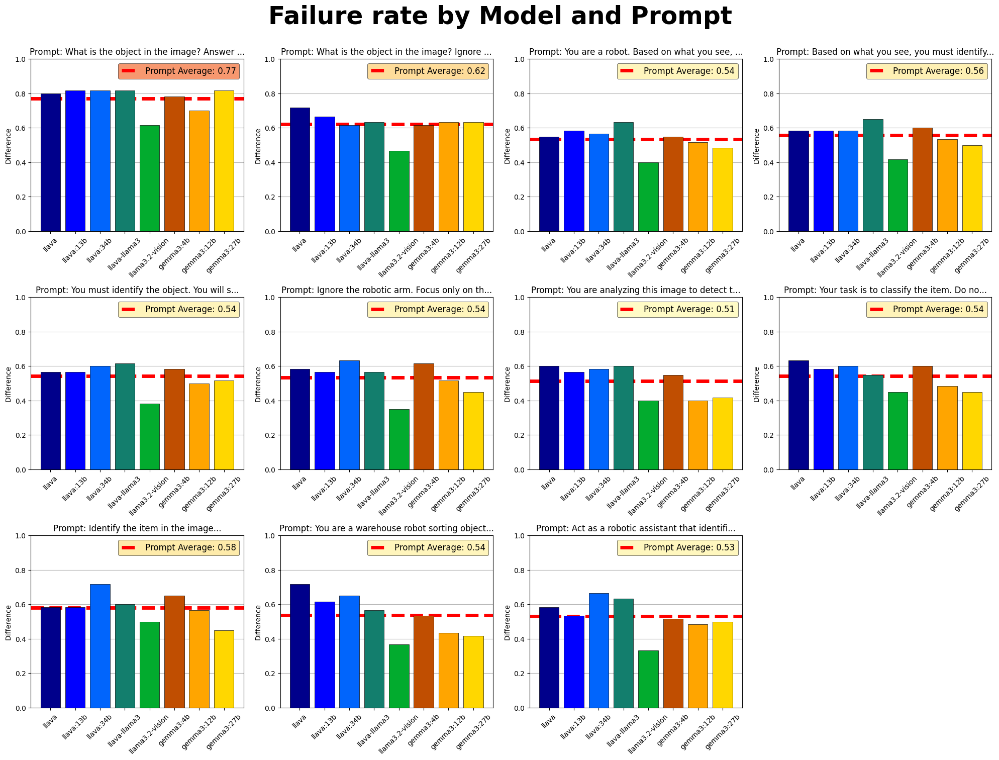

In [10]:
unique_prompts = responses["prompt"].unique()
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for idx, prompt in enumerate(unique_prompts[:12]):
    ax = axes[idx]
    ax.grid(axis="y")
    prompt_mean = 0
    for i, model_name in enumerate(responses["model"].unique()):
        differences = responses[(responses["prompt"] == prompt) & (responses["model"] == model_name)]["success"]
        ax.bar(
            model_name,
            1 - differences.mean(),
            #label=model_name,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,   
        )
        prompt_mean += 1 - differences.mean()
    prompt_mean = prompt_mean / len(responses["model"].unique())
    ax.axhline(prompt_mean, color='red', lw=5, ls='--', label="Prompt Average: " + str(round(prompt_mean, 2)))
    
    ax.set_ylim(0, 1)
    ax.set_xticks(range(len(responses["model"].unique())))
    ax.set_xticklabels(responses["model"].unique(), rotation=45)
    ax.set_title(f"Prompt: {prompt[:40]}...")
    ax.set_ylabel("Difference")
    #ax.legend(fontsize=12)
    legend = ax.legend(fontsize=12)
    legend.get_frame().set_facecolor(plt.cm.RdYlGn_r((prompt_mean - 0.0) / (1 - 0.0)))
    legend.get_frame().set_edgecolor("black")
    legend.get_frame().set_linewidth(0.5)


for idx in range(len(unique_prompts), len(axes)):
    fig.delaxes(axes[idx])

plt.suptitle("Failure rate by Model and Prompt", fontsize=35, fontweight='bold', y=1.005)
plt.tight_layout()
plt.show()

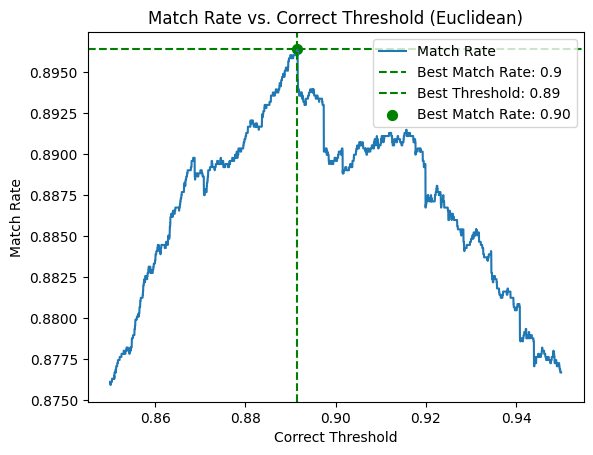

Best Threshold: 0.8915341534153415 | Match rate: 0.90 | Correct rate: 0.43 | Success rate: 0.43


In [11]:
threshold_range = np.linspace(0.85, 0.95, 10000)

best_match_rate = 0
best_threshold = 0
best_correct_rate = 0
best_success_rate = 0

match_rates = []

for correct_threshold in threshold_range:
    corrects = np.array(responses["difference"]) < correct_threshold
    successes = np.array(responses["success"])
    match_rate = np.mean(corrects == successes)
    match_rates.append(match_rate)
    if match_rate > best_match_rate:
        best_match_rate = match_rate
        best_threshold = correct_threshold
        best_correct_rate = np.mean(corrects)
        best_success_rate = np.mean(successes)

plt.plot(threshold_range, match_rates, label="Match Rate")
plt.axhline(y=best_match_rate, color='g', linestyle='--', label="Best Match Rate: " + str(round(best_match_rate, 2)))
plt.axvline(x=best_threshold, color='g', linestyle='--', label="Best Threshold: " + str(round(best_threshold, 2)))
plt.scatter([best_threshold], [best_match_rate], color='g', s=50, label=f"Best Match Rate: {best_match_rate:.2f}")

plt.title("Match Rate vs. Correct Threshold (Euclidean)")
plt.xlabel("Correct Threshold")
plt.ylabel("Match Rate")
plt.legend()
plt.show()

print(f"Best Threshold: {best_threshold} | Match rate: {best_match_rate:.2f} | Correct rate: {best_correct_rate:.2f} | Success rate: {best_success_rate:.2f}")

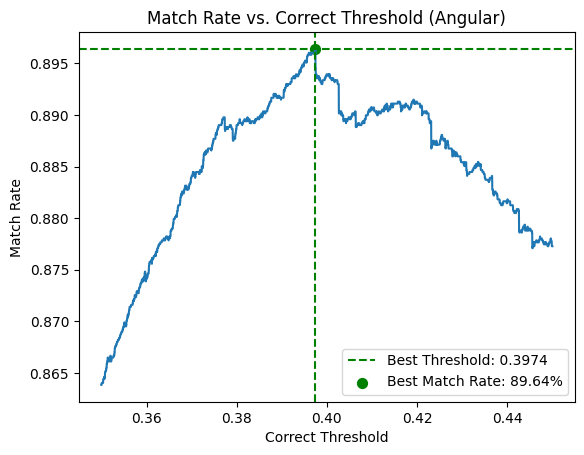

Best Threshold: 0.3974147414741474 | Match rate: 0.8964 | Correct rate: 0.4313 | Success rate: 0.4299


In [39]:
threshold_range = np.linspace(0.35, 0.45, 10000)

best_match_rate = 0
best_threshold = 0
best_correct_rate = 0
best_success_rate = 0

match_rates = []

for correct_threshold in threshold_range:
    corrects = np.array(responses["angular_difference"]) < correct_threshold
    successes = np.array(responses["success"])
    match_rate = np.mean(corrects == successes)
    match_rates.append(match_rate)
    if match_rate > best_match_rate:
        best_match_rate = match_rate
        best_threshold = correct_threshold
        best_correct_rate = np.mean(corrects)
        best_success_rate = np.mean(successes)

plt.plot(threshold_range, match_rates) #, label="Match Rate")
plt.axhline(y=best_match_rate, color='g', linestyle='--')
plt.axvline(x=best_threshold, color='g', linestyle='--', label="Best Threshold: " + str(round(best_threshold, 4)))
plt.scatter([best_threshold], [best_match_rate], color='g', s=50, label=f"Best Match Rate: {100*best_match_rate:.2f}%")

plt.title("Match Rate vs. Correct Threshold (Angular)")
plt.xlabel("Correct Threshold")
plt.ylabel("Match Rate")
plt.legend()
plt.show()

print(f"Best Threshold: {best_threshold} | Match rate: {best_match_rate:.4f} | Correct rate: {best_correct_rate:.4f} | Success rate: {best_success_rate:.4f}")

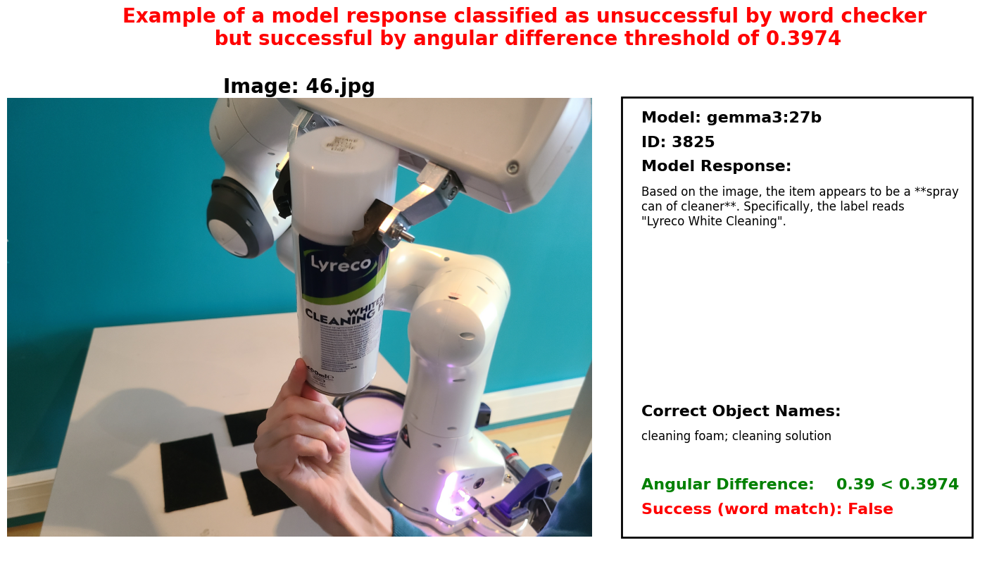

In [52]:
ang_diff_threshold = 0.3974
corrects = np.array(responses["angular_difference"]) < ang_diff_threshold
successes = np.array(responses["success"])

different_indexes = np.where((corrects == True) & (successes == False))[0]
different_response = responses.iloc[different_indexes[np.random.randint(0, len(different_indexes))]]
different_response = responses.iloc[3825]

image_path = "images/" + different_response["image_name"]
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8), gridspec_kw={'width_ratios': [3, 2]})

try:
    image = Image.open(image_path)
    ax1.imshow(image)
    ax1.axis('off')
    ax1.set_title(f"Image: {different_response['image_name']}", fontsize=20, fontweight="bold")
except FileNotFoundError:
    ax1.text(0.5, 0.5, "Image not found", ha="center", va="center", fontsize=20)
    ax1.axis('off')

ax2.axis('off')
ax2.text(0.1, 0.9, f"Model: {different_response['model']}", fontsize=16, fontweight="bold")
ax2.text(0.1, 0.85, f"ID: {different_response.name}", fontsize=16, fontweight="bold")
ax2.text(0.1, 0.8, "Model Response:", fontsize=16, fontweight="bold")
wrapped_response = textwrap.fill(different_response["model_response"], width=53)
ax2.text(0.1, 0.77, wrapped_response, fontsize=12, verticalalignment="top")

ax2.text(0.1, 0.30, "Correct Object Names:", fontsize=16, fontweight="bold")
wrapped_objects = textwrap.fill(different_response["correct_object_names"], width=53)
ax2.text(0.1, 0.27, wrapped_objects, fontsize=12, verticalalignment="top")

ax2.text(0.1, 0.15, f"Angular Difference:    {different_response['angular_difference']:.2f} < {ang_diff_threshold}", fontsize=16, fontweight="bold", color="g")
ax2.text(0.1, 0.10, f"Success (word match): {different_response['success']}", fontsize=16, fontweight="bold", color="r")

ax2.add_patch(plt.Rectangle((0.05, 0.05), 0.9, 0.9, fill=False, edgecolor='black', linewidth=2))

plt.suptitle(f"Example of a model response classified as unsuccessful by word checker\n but successful by angular difference threshold of {ang_diff_threshold}", fontsize=20, fontweight="bold", color="red", y=1.005)
plt.tight_layout()
plt.show()

---

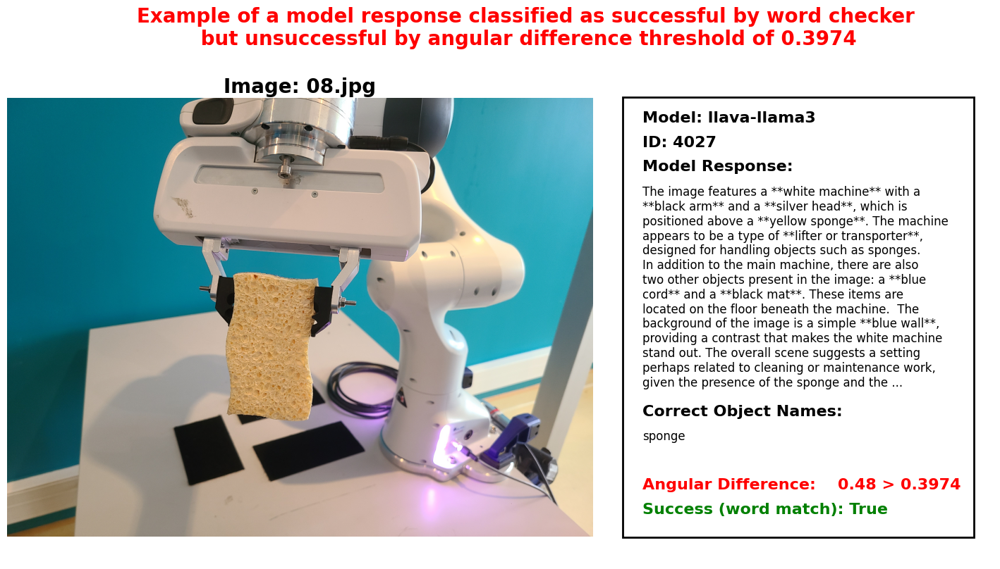

In [ ]:
ang_diff_threshold = 0.3974
corrects = np.array(responses["angular_difference"]) < ang_diff_threshold
successes = np.array(responses["success"])

different_indexes = np.where((corrects == False) & (successes == True))[0]
different_response = responses.iloc[different_indexes[np.random.randint(0, len(different_indexes))]]
#different_response = responses.iloc[4027]

image_path = "images/" + different_response["image_name"]
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8), gridspec_kw={'width_ratios': [3, 2]})

try:
    image = Image.open(image_path)
    ax1.imshow(image)
    ax1.axis('off')
    ax1.set_title(f"Image: {different_response['image_name']}", fontsize=20, fontweight="bold")
except FileNotFoundError:
    ax1.text(0.5, 0.5, "Image not found", ha="center", va="center", fontsize=20)
    ax1.axis('off')

ax2.axis('off')
ax2.text(0.1, 0.9, f"Model: {different_response['model']}", fontsize=16, fontweight="bold")
ax2.text(0.1, 0.85, f"ID: {different_response.name}", fontsize=16, fontweight="bold")
ax2.text(0.1, 0.8, "Model Response:", fontsize=16, fontweight="bold")
wrapped_response = different_response["model_response"][:669] + "..." if len(different_response["model_response"]) > 665 else different_response["model_response"]
wrapped_response = textwrap.fill(wrapped_response, width=50)
ax2.text(0.1, 0.77, wrapped_response, fontsize=12, verticalalignment="top")

ax2.text(0.1, 0.30, "Correct Object Names:", fontsize=16, fontweight="bold")
wrapped_objects = textwrap.fill(different_response["correct_object_names"], width=50)
ax2.text(0.1, 0.27, wrapped_objects, fontsize=12, verticalalignment="top")

ax2.text(0.1, 0.15, f"Angular Difference:    {different_response['angular_difference']:.2f} > {ang_diff_threshold}", fontsize=16, fontweight="bold", color="r")
ax2.text(0.1, 0.10, f"Success (word match): {different_response['success']}", fontsize=16, fontweight="bold", color="g")

ax2.add_patch(plt.Rectangle((0.05, 0.05), 0.9, 0.9, fill=False, edgecolor='black', linewidth=2))

plt.suptitle(f"Example of a model response classified as successful by word checker\n but unsuccessful by angular difference threshold of {ang_diff_threshold}", fontsize=20, fontweight="bold", color="red", y=1.005)
plt.tight_layout()
plt.show()

---

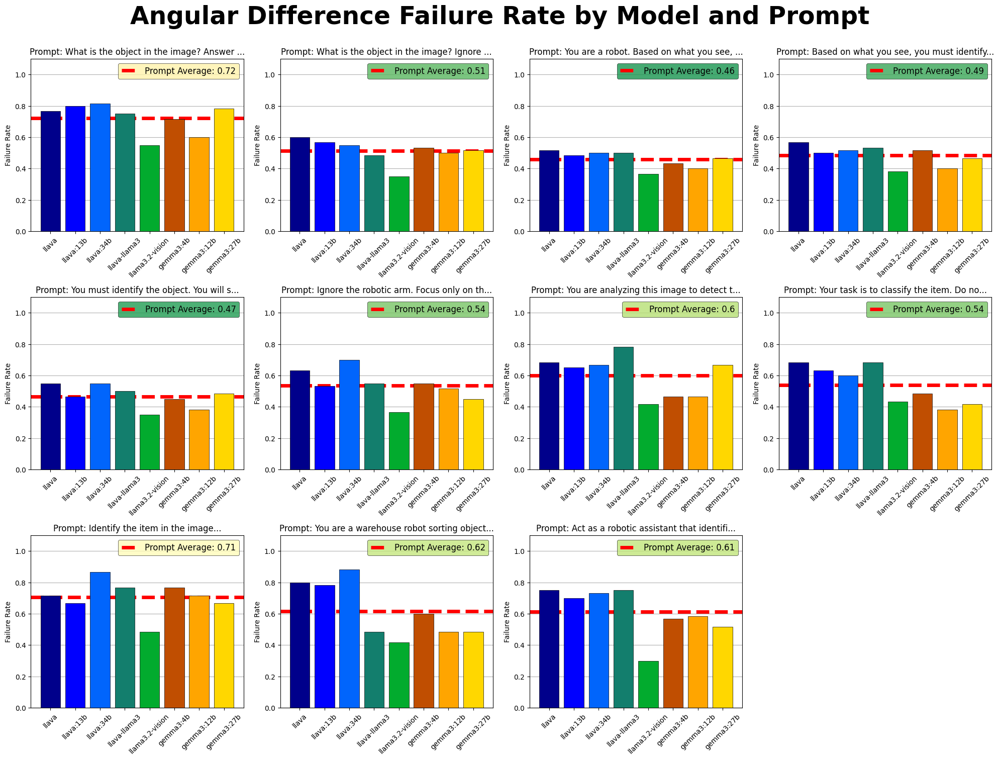

In [41]:
unique_prompts = responses["prompt"].unique()
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

# ==========================
correct_threshold = 0.3974
# ==========================

for idx, prompt in enumerate(unique_prompts[:12]):
    ax = axes[idx]
    ax.grid(axis="y")
    prompt_mean = 0
    for i, model_name in enumerate(responses["model"].unique()):
        differences = responses[(responses["prompt"] == prompt) & (responses["model"] == model_name)]["angular_difference"]
        
        correct_guess_rate = 1 - np.mean(differences < correct_threshold)
        ax.bar(
            model_name,
            correct_guess_rate,
            #label=model_name,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,   
        )
        prompt_mean += correct_guess_rate
    prompt_mean = prompt_mean / len(responses["model"].unique())
    ax.axhline(prompt_mean, color='red', lw=5, ls='--', label="Prompt Average: " + str(round(prompt_mean, 2)))
    
    ax.set_ylim(0, 1.1)
    ax.set_xticks(range(len(responses["model"].unique())))
    ax.set_xticklabels(responses["model"].unique(), rotation=45)
    ax.set_title(f"Prompt: {prompt[:40]}...")
    ax.set_ylabel("Failure Rate")
    #ax.legend(fontsize=12)
    legend = ax.legend(fontsize=12)
    legend.get_frame().set_facecolor(plt.cm.RdYlGn_r((prompt_mean - 0.4) / (1 - 0.4)))
    legend.get_frame().set_edgecolor("black")
    legend.get_frame().set_linewidth(0.5)


for idx in range(len(unique_prompts), len(axes)):
    fig.delaxes(axes[idx])

plt.suptitle("Angular Difference Failure Rate by Model and Prompt", fontsize=35, fontweight='bold', y=1.005)
plt.tight_layout()
plt.show()

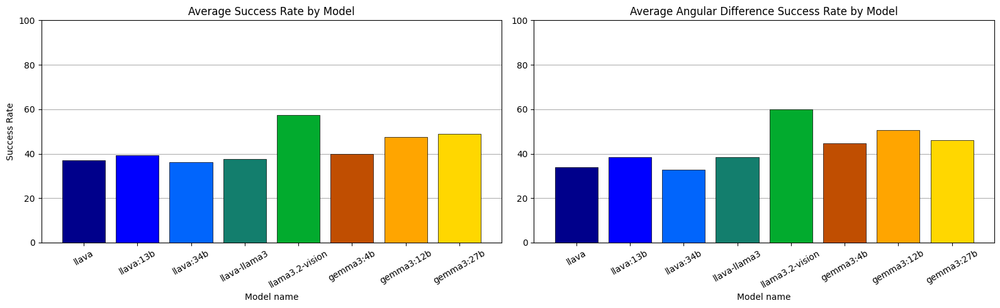

In [44]:
plt.figure(figsize=(16, 5))
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]

plt.subplot(1, 2, 1)
plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    plt.bar(
        model_name,
        100 * responses[responses["model"] == model_name]["success"].mean(),
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )

plt.ylim(0, 100)
plt.title("Average Success Rate by Model")
plt.xlabel("Model name")
plt.ylabel("Success Rate")
plt.xticks(rotation=30)

plt.subplot(1, 2, 2)
plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    plt.bar(
        model_name,
        100 * np.mean(responses[responses["model"] == model_name]["angular_difference"] <= 0.3974),
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )

plt.ylim(0, 100)
plt.title("Average Angular Difference Success Rate by Model")
plt.xlabel("Model name")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()

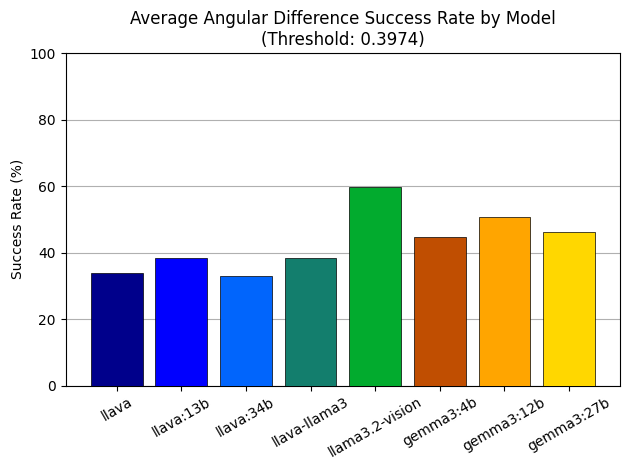

In [48]:
plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    plt.bar(
        model_name,
        100 * np.mean(responses[responses["model"] == model_name]["angular_difference"] <= 0.3974),
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )

plt.ylim(0, 100)
plt.title("Average Angular Difference Success Rate by Model\n(Threshold: 0.3974)")
plt.ylabel("Success Rate (%)")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()

---

In [14]:
def get_diff_for_model_prompt_image(df, model_name, prompt, image_name, diff_type="difference"):
    return df[(df["model"] == model_name) & (df["prompt"] == prompt) & (df["image_name"] == image_name)][diff_type].iloc[0]
    
def show_img(photo_id):
    try:
        img_path = "images/" + responses["image_name"].unique()[photo_id]
        img = Image.open(img_path)
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Image: {responses['image_name'].unique()[photo_id]}")
        plt.show()
    except FileNotFoundError:
        print(f"Image file not found: {img_path}")
          
def compare_model_responses(df, prompt_id, photo_id, diff_type="difference"):
    prompt_id = prompt_id%len(df["prompt"].unique())
    photo_id = photo_id%len(df["image_name"].unique())
    image_name = df["image_name"].unique()[photo_id]
    prompt = df["prompt"].unique()[prompt_id]
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
    
    try:
        img_path = "images/" + image_name
        img = Image.open(img_path)
        ax1.imshow(img)
        ax1.axis('off')
        ax1.set_title(f"Image: {image_name}", fontsize=20, fontweight="bold")
    except FileNotFoundError:
        ax1.text(0.5, 0.5, f"Image file not found: {img_path}", 
                 ha='center', va='center', fontsize=20, fontweight="bold")
        ax1.axis('off')
    
    expected_desc = df[(df["prompt"] == prompt) & (df["image_name"] == image_name)]["correct_object_names"].iloc[0]
    ax2.grid(axis="y")
    ax2.set_title(f"Model responses and embedding differences\nExpected descriptions: {expected_desc}\nPrompt: {prompt}\n")
    ax2.set_ylabel("Difference")
    ax2.tick_params(axis='x', rotation=45)
    
    res = []
    for i, m in enumerate(df["model"].unique()):
        model_diff = get_diff_for_model_prompt_image(df, m, prompt, image_name, diff_type)
        res.append(model_diff)
        label = df[(df["model"] == m) & (df["prompt"] == prompt) & (df["image_name"] == image_name)]["model_response"].iloc[0]
        if len(label) > 100:
            label = textwrap.shorten(label, width=100, placeholder="...")
        label = label.replace("\n", " ")
        success = df[(df["model"] == m) & (df["prompt"] == prompt) & (df["image_name"] == image_name)]["success"].iloc[0]
        ax2.bar(
            m,
            model_diff,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,
            label=label,
        )
        ax2.annotate(
            f"{model_diff:.2f}",
            (i, model_diff),
            textcoords="offset points",
            xytext=(0, 10),
            ha='center',
            fontsize=12,
            color="black",
        )
        marker = "✔" if success else "✘"
        marker_color = "green" if success else "red"
        ax2.annotate(
            marker,
            (i, model_diff),
            textcoords="offset points",
            xytext=(0, 25),
            ha='center',
            fontsize=14,
            color=marker_color,
            fontweight='bold',
        )
    
    if diff_type == "difference":
        ax2.set_ylim(0, 1.3)
    elif diff_type == "angular_difference":
        ax2.set_ylim(0, 0.9)
    ax2.legend(
        loc='upper left', bbox_to_anchor=(1, 1), fontsize=10, title="Model Responses",
        title_fontsize='13', frameon=True, shadow=True, fancybox=True, borderpad=1,
        facecolor='lightgray', edgecolor='black', labelspacing=1.2
    )
    
    plt.tight_layout()
    plt.show()
    
    return res


---

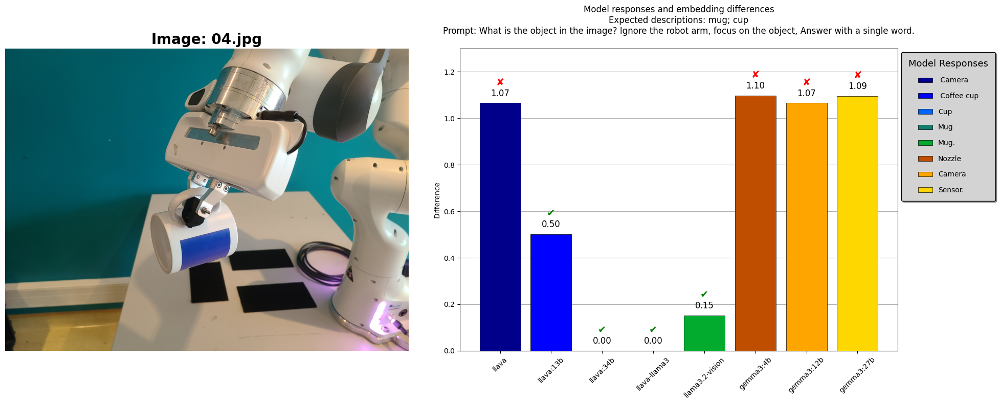

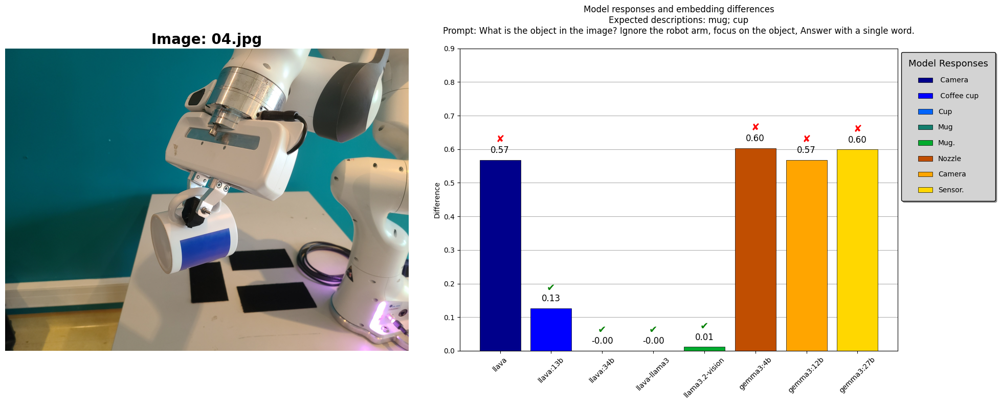

In [199]:
prompt_id = 1
photo_id = 3

compare_model_responses(responses, prompt_id, photo_id, diff_type="difference")
compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

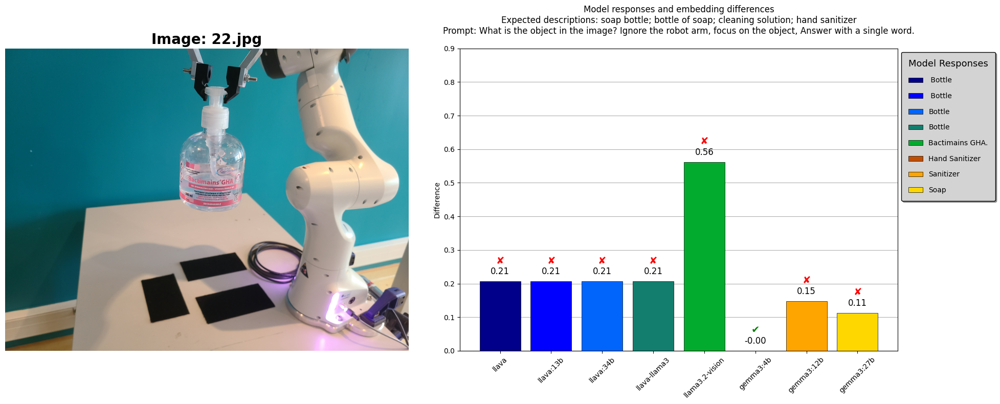

In [200]:
prompt_id = 1
photo_id = 21

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

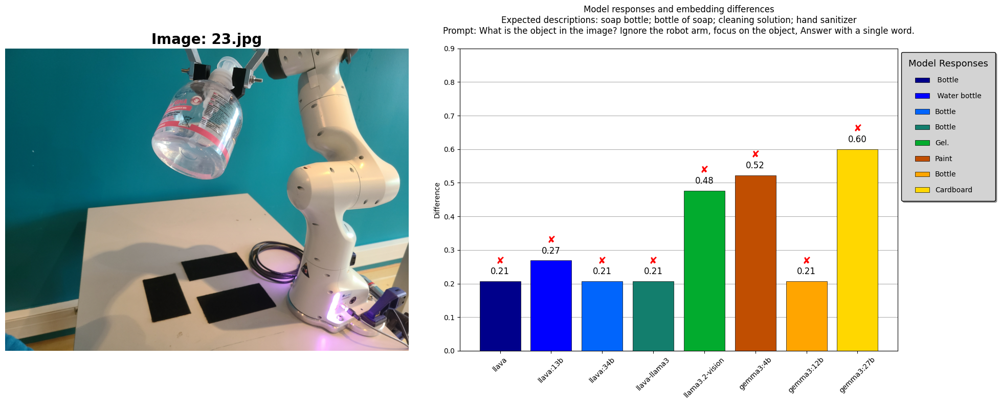

In [201]:
prompt_id = 1
photo_id = 22

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

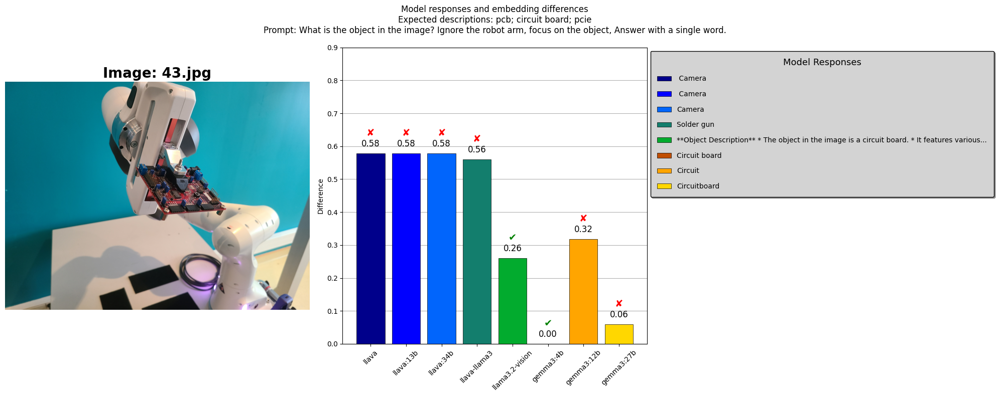

In [202]:
prompt_id = 1
photo_id = 42

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

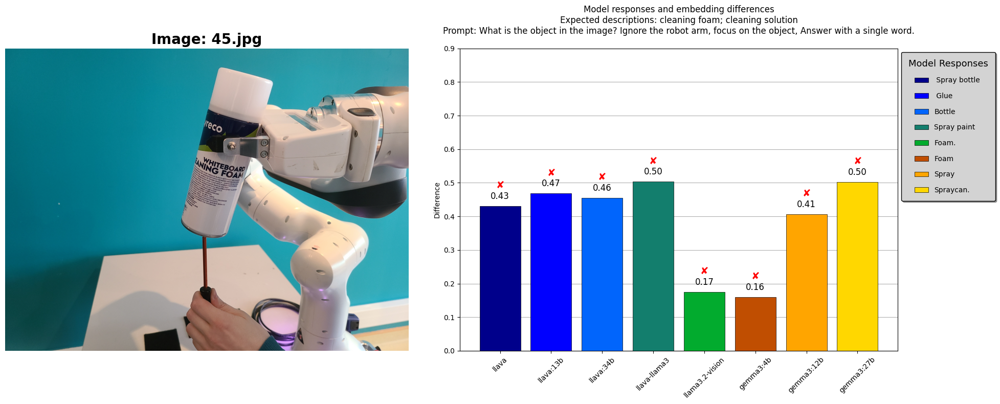

In [203]:
prompt_id = 1
photo_id = 44

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

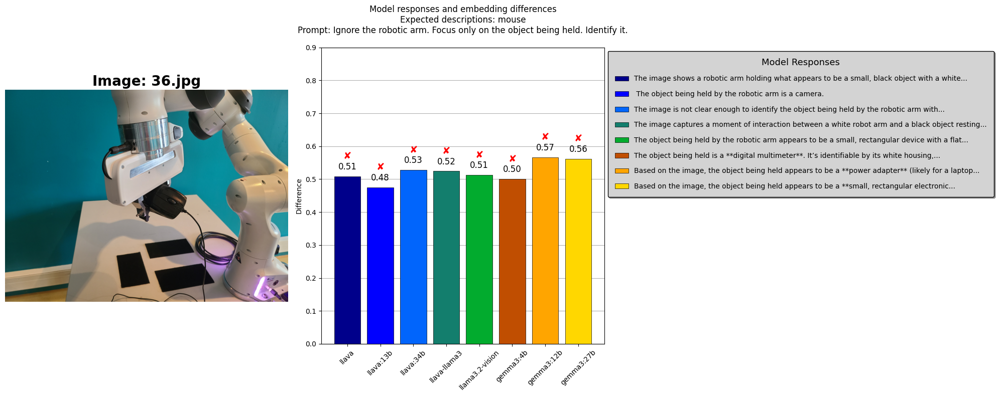

In [236]:
prompt_id = 5
photo_id = 35

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

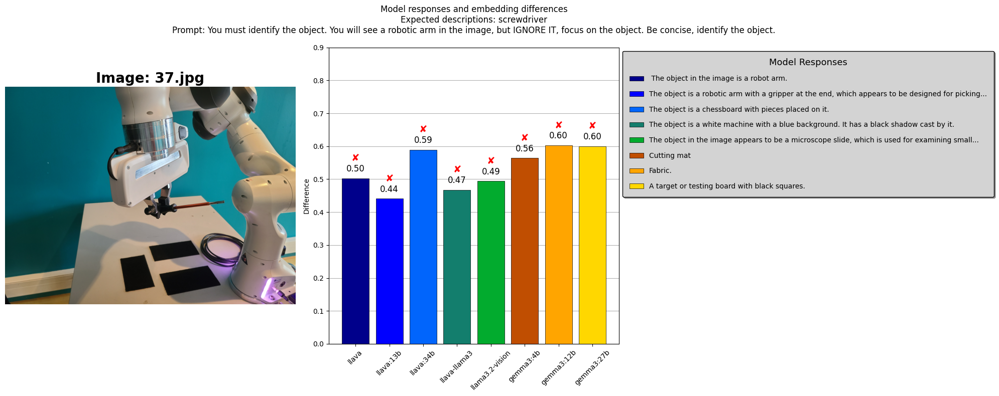

In [237]:
prompt_id = 4
photo_id = 36

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

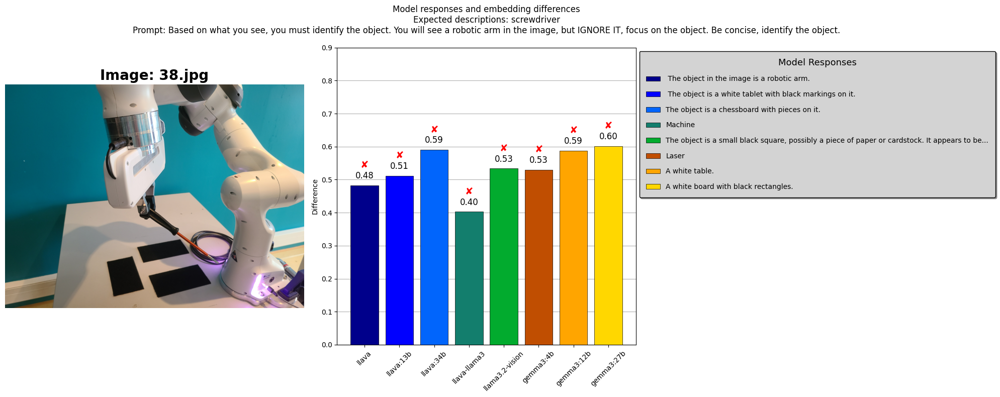

In [238]:
prompt_id = 3
photo_id = 37

compare_model_responses(responses, prompt_id, photo_id, diff_type="angular_difference")
print()

---

In [231]:
def plot_model_responses_grid(df, model_name, diff_type="difference"):
    unique_prompts = df["prompt"].unique()
    unique_photos = df["image_name"].unique()
    n_prompts = len(unique_prompts)
    n_photos = len(unique_photos)
    
    grid_data = np.zeros((n_prompts, n_photos))
    
    for i, prompt in enumerate(unique_prompts):
        for j, photo in enumerate(unique_photos):
            grid_data[i, j] = get_diff_for_model_prompt_image(df, model_name, prompt, photo, diff_type)
    
    plt.figure(figsize=(n_photos, n_prompts))
    plt.imshow(grid_data, cmap="RdYlGn_r", aspect="auto", interpolation="nearest")
    plt.colorbar(label="Difference")
    plt.xticks(range(n_photos), [photo[:10] for photo in unique_photos], rotation=45, ha="right")
    plt.yticks(range(n_prompts), [prompt[:40] + "..." for prompt in unique_prompts])
    plt.title(f"Model Responses and Embedding Differences for {model_name}")
    plt.xlabel("Photo")
    plt.ylabel("Prompt")
    plt.tight_layout()
    plt.savefig(f"output/{model_name}_{diff_type[:3]}_grid.png")
    plt.show()




=== llava ===


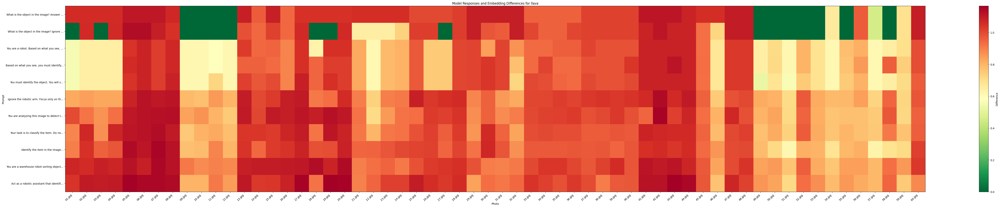

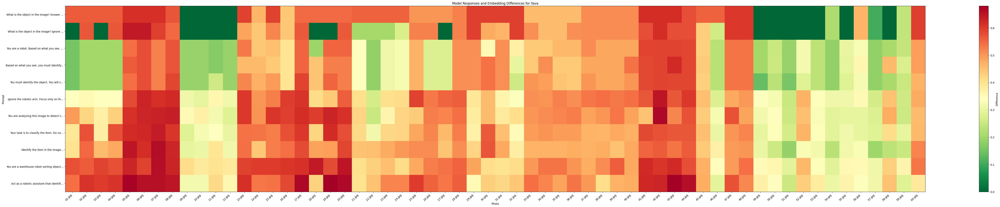



=== llava:13b ===


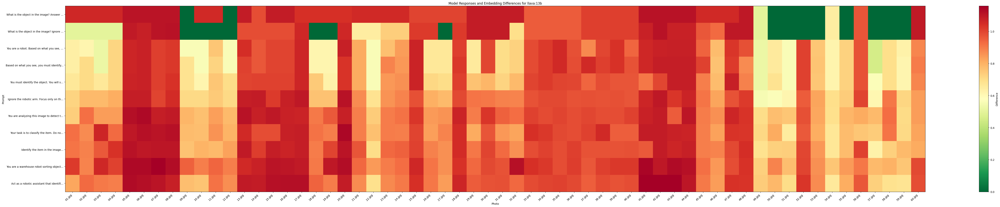

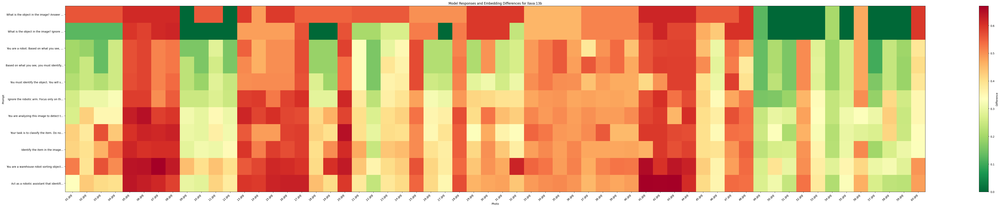



=== llava:34b ===


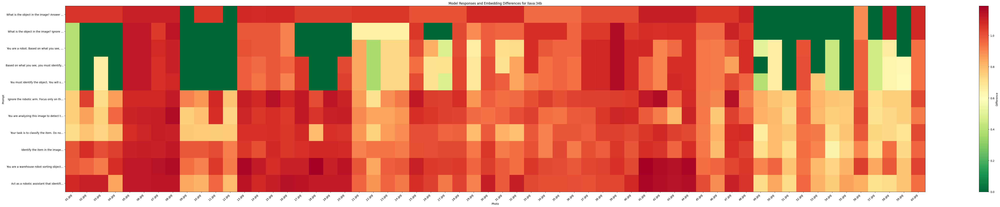

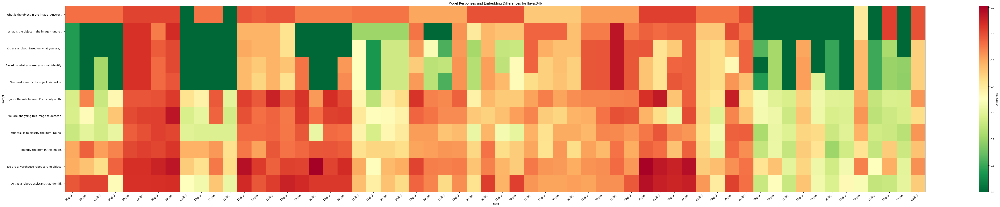



=== llava-llama3 ===


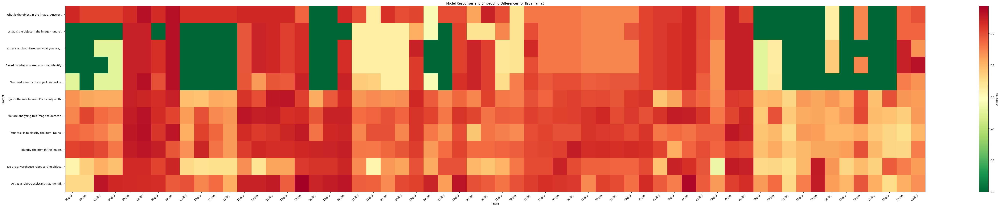

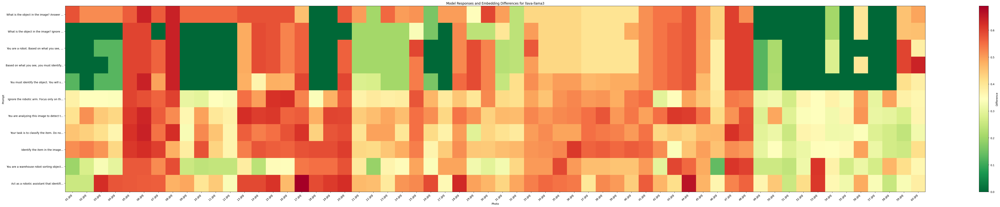



=== llama3.2-vision ===


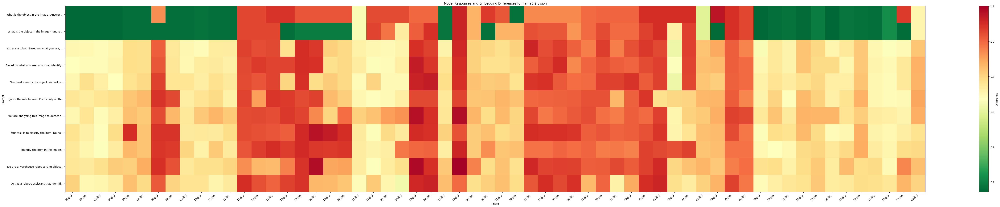

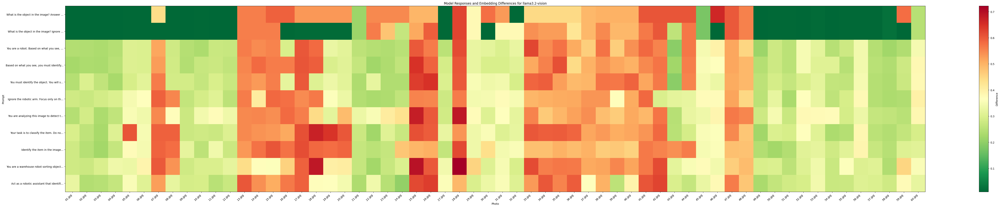



=== gemma3:4b ===


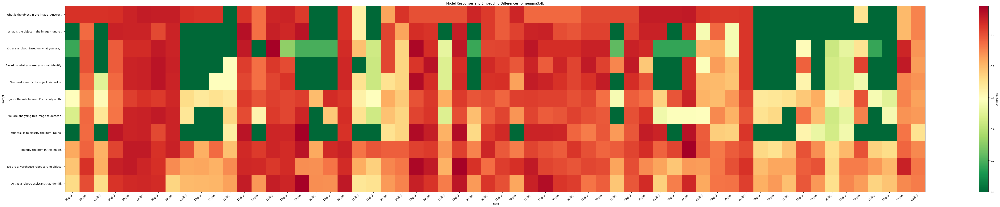

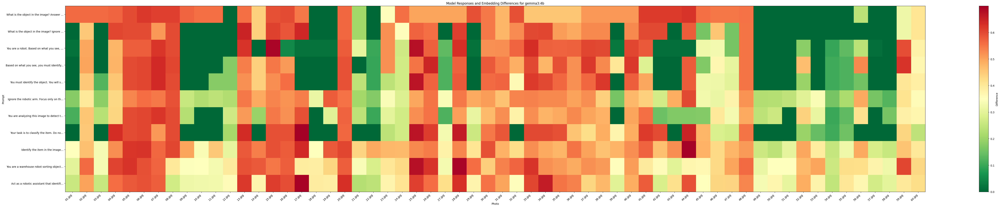



=== gemma3:12b ===


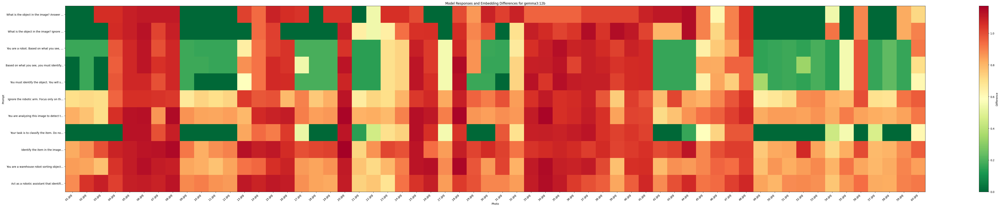

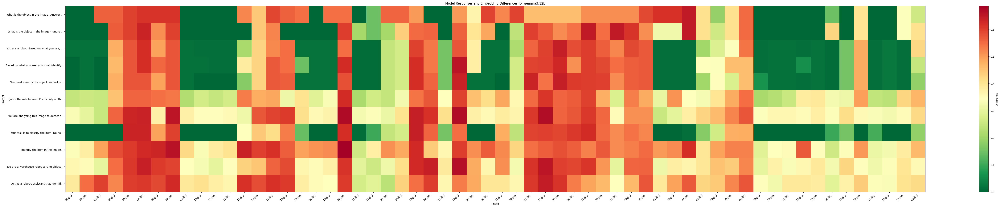



=== gemma3:27b ===


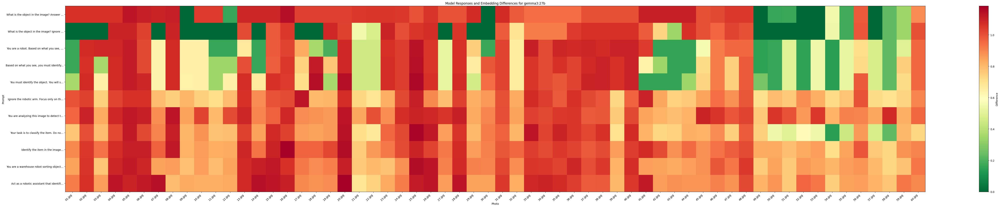

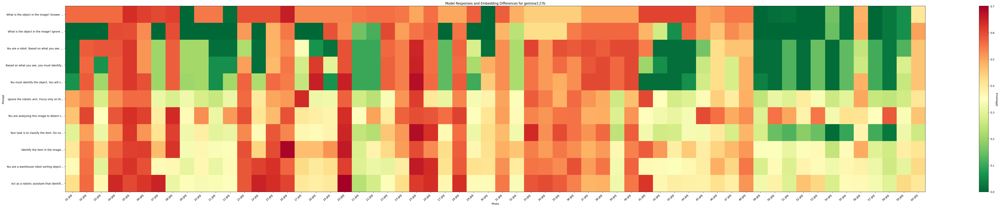

In [232]:
for model_name in responses["model"].unique():
    print(f"\n\n=== {model_name} ===")
    plot_model_responses_grid(responses, model_name, diff_type="difference")
    plot_model_responses_grid(responses, model_name, diff_type="angular_difference")

In [233]:
def plot_overall_average_grid(df, diff_type="difference"):
    unique_prompts = df["prompt"].unique()
    unique_photos = df["image_name"].unique()
    n_prompts = len(unique_prompts)
    n_photos = len(unique_photos)
    
    grid_data = np.zeros((n_prompts, n_photos))
    
    for i, prompt in enumerate(unique_prompts):
        for j, photo in enumerate(unique_photos):
            model_diffs = []
            for model_name in df["model"].unique():
                model_diff = get_diff_for_model_prompt_image(df, model_name, prompt, photo, diff_type)
                model_diffs.append(model_diff)
            grid_data[i, j] = np.mean(model_diffs)
    
    plt.figure(figsize=(n_photos, n_prompts))
    plt.imshow(grid_data, cmap="RdYlGn_r", aspect="auto", interpolation="nearest")
    plt.colorbar(label="Difference")
    plt.xticks(range(n_photos), [photo[:10] for photo in unique_photos], rotation=45, ha="right")
    plt.yticks(range(n_prompts), [prompt[:40] + "..." for prompt in unique_prompts])
    plt.title(f"Overall Average Model Responses and Embedding Differences")
    plt.xlabel("Photo")
    plt.ylabel("Prompt")
    plt.tight_layout()
    plt.savefig(f"output/overall_{diff_type[:3]}_grid.png")
    plt.show()

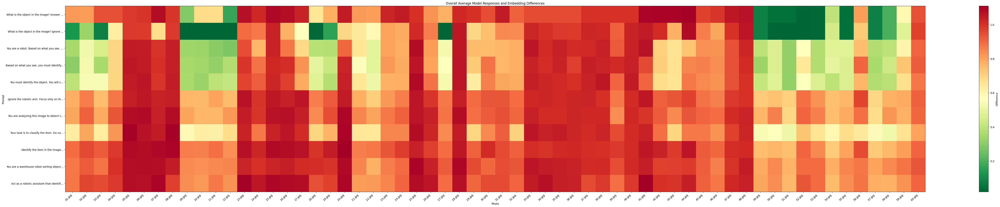

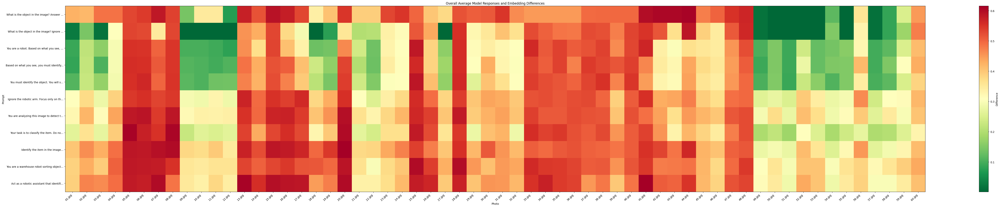

In [234]:
plot_overall_average_grid(responses, diff_type="difference")
plot_overall_average_grid(responses, diff_type="angular_difference")

---

In [502]:
def plot_model_responses_success_grid(df, model_name, threshold=0.3974):
    unique_prompts = df["prompt"].unique()
    unique_photos = df["image_name"].unique()
    n_prompts = len(unique_prompts)
    n_photos = len(unique_photos)
    
    grid_data = np.zeros((n_prompts, n_photos))
    
    for i, prompt in enumerate(unique_prompts):
        for j, photo in enumerate(unique_photos):
            grid_data[i, j] = get_diff_for_model_prompt_image(df, model_name, prompt, photo, "angular_difference") > threshold
    
    plt.figure(figsize=(n_photos, n_prompts))
    plt.imshow(grid_data, cmap="RdYlGn_r", aspect="auto", interpolation="nearest")
    plt.colorbar(label="Difference")
    plt.xticks(range(n_photos), [photo[:10] for photo in unique_photos], rotation=45, ha="right")
    plt.yticks(range(n_prompts), [prompt[:40] + "..." for prompt in unique_prompts])
    plt.title(f"Model Responses and Embedding Differences for {model_name}")
    plt.xlabel("Photo")
    plt.ylabel("Prompt")
    plt.tight_layout()
    plt.savefig(f"output/{model_name}_angular_success_grid.png")
    plt.show()




=== llama3.2-vision ===


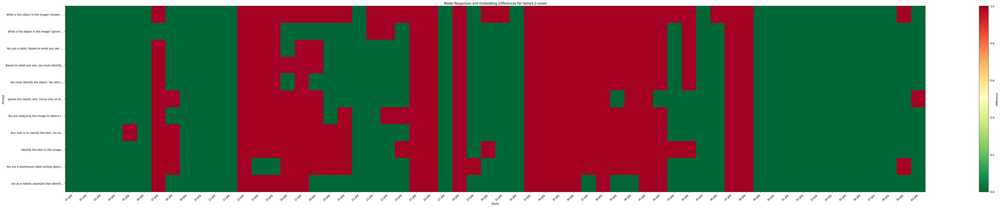

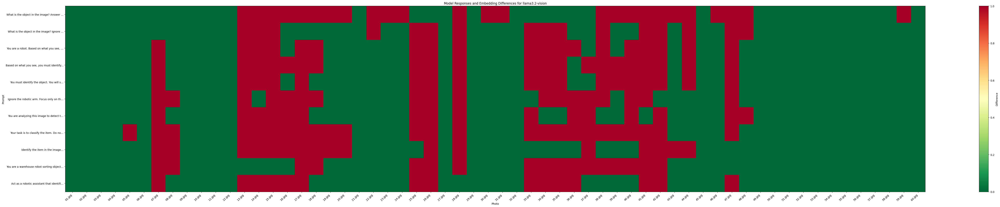

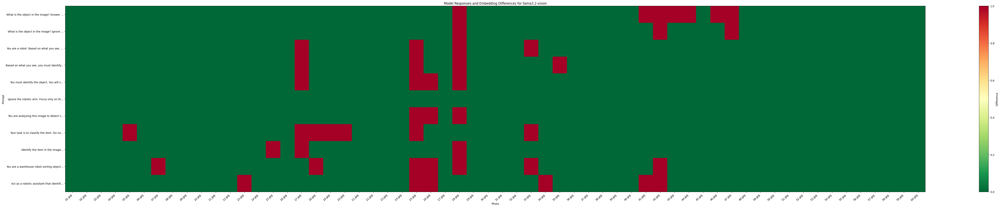

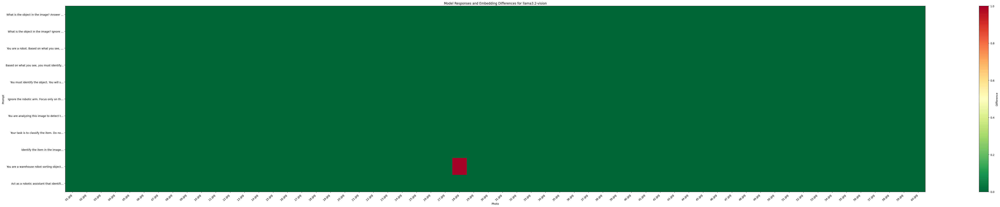

In [507]:
model_name = responses["model"].unique()[4]
print(f"\n\n=== {model_name} ===")
plot_model_responses_success_grid(responses, model_name, threshold=0.3974)
plot_model_responses_success_grid(responses, model_name, threshold=0.5)
plot_model_responses_success_grid(responses, model_name, threshold=0.6)
plot_model_responses_success_grid(responses, model_name, threshold=0.7)



=== llava ===


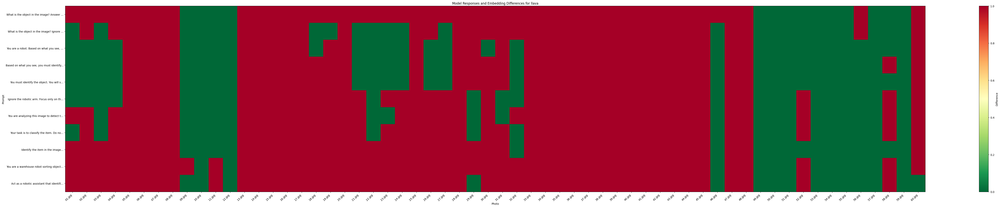



=== llava:13b ===


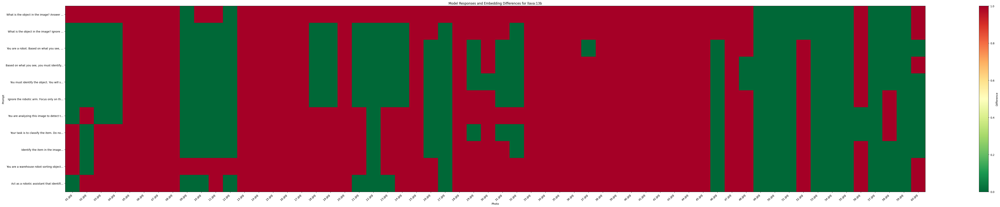



=== llava:34b ===


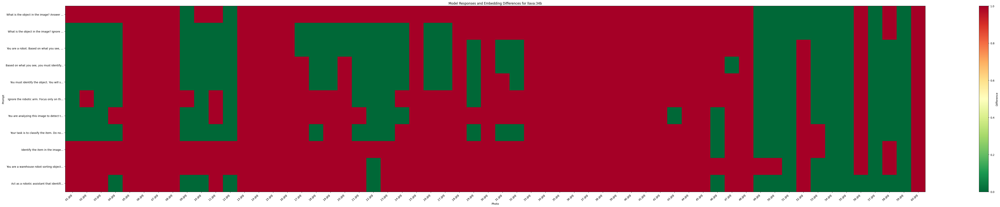



=== llava-llama3 ===


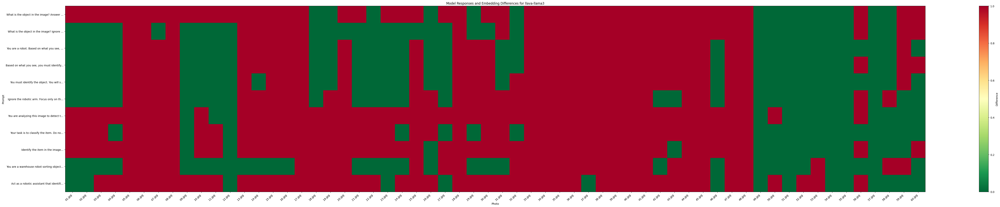



=== llama3.2-vision ===


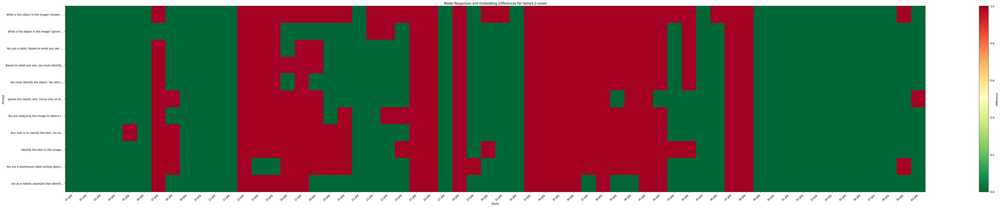



=== gemma3:4b ===


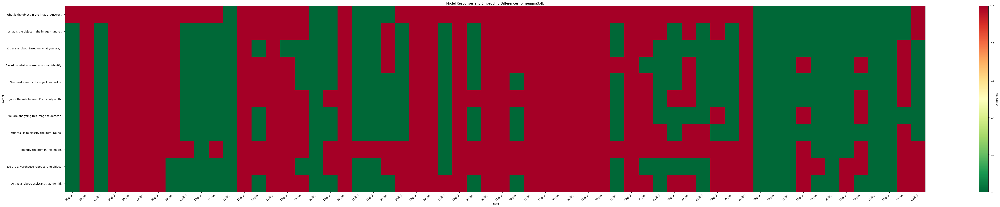



=== gemma3:12b ===


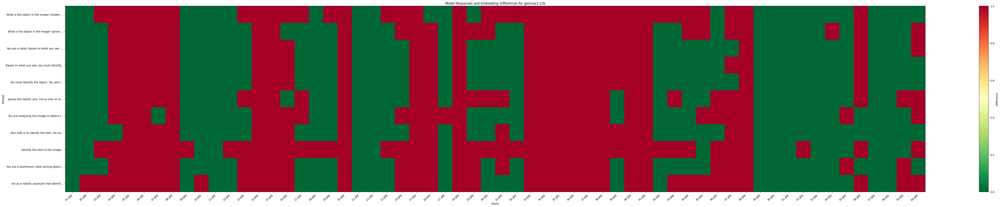



=== gemma3:27b ===


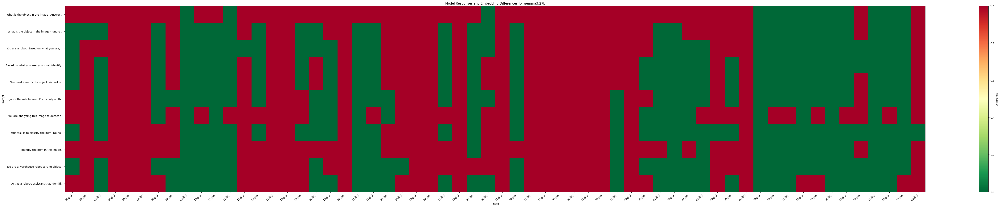

In [503]:
for model_name in responses["model"].unique():
    print(f"\n\n=== {model_name} ===")
    plot_model_responses_success_grid(responses, model_name, threshold=0.3974)

---

## FULL GUESSER

In [13]:
def full_guesser(df, index, threshold=0.3974):
    row = df.iloc[index]
    model_name = row["model"]
    prompt = row["prompt"]
    success = row["success"]
    angular_diff = row["angular_difference"]

    image_name = row["image_name"]
    image_path = "images/" + image_name
    
    model_response = row["model_response"]
    correct_object_names = row["correct_object_names"]
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8), gridspec_kw={'width_ratios': [3, 2]})

    try:
        image = Image.open(image_path)
        ax1.imshow(image)
        ax1.axis('off')
        ax1.set_title(f"Image: {image_name}", fontsize=20, fontweight="bold")
    except FileNotFoundError:
        ax1.text(0.5, 0.5, "Image not found", ha="center", va="center", fontsize=20)
        ax1.axis('off')

    ax2.axis('off')
    ax2.text(0.1, 0.9, f"Model: {model_name}", fontsize=16, fontweight="bold")
    ax2.text(0.1, 0.85, f"ID: {index}", fontsize=16, fontweight="bold")

    ax2.text(0.1, 0.80, f"Prompt:", fontsize=16, fontweight="bold")
    wrapped_prompt = textwrap.fill(prompt, width=50)
    ax2.text(0.1, 0.77, wrapped_prompt, fontsize=12, verticalalignment="top")

    ax2.text(0.1, 0.60, "Model Response:", fontsize=16, fontweight="bold")
    wrapped_response = model_response[:300] + "..." if len(model_response) > 300 else model_response
    wrapped_response = textwrap.fill(wrapped_response, width=50)
    ax2.text(0.1, 0.57, wrapped_response, fontsize=12, verticalalignment="top")

    ax2.text(0.1, 0.30, "Correct Object Names:", fontsize=16, fontweight="bold")
    wrapped_objects = textwrap.fill(correct_object_names, width=50)
    ax2.text(0.1, 0.27, wrapped_objects, fontsize=12, verticalalignment="top")

    if angular_diff < threshold:
        ax2.text(0.1, 0.17, f"Angular Difference:    {angular_diff:.2f} < {threshold}", fontsize=16, fontweight="bold", color="g")
    else:
        ax2.text(0.1, 0.17, f"Angular Difference:    {angular_diff:.2f} > {threshold}", fontsize=16, fontweight="bold", color="r")

    if success:
        ax2.text(0.1, 0.12, f"Success (word match): {success}", fontsize=16, fontweight="bold", color="g")
    else:
        ax2.text(0.1, 0.12, f"Success (word match): {success}", fontsize=16, fontweight="bold", color="r")
        
    final_success = True if success else angular_diff < threshold
    if final_success:
        ax2.text(0.1, 0.07, f"Final Success: {final_success}", fontsize=16, fontweight="bold", color="g")
    else:
        ax2.text(0.1, 0.07, f"Final Success: {final_success}", fontsize=16, fontweight="bold", color="r")

    ax2.add_patch(plt.Rectangle((0.05, 0.05), 0.9, 0.9, fill=False, edgecolor='black', linewidth=2))

    plt.suptitle(f"Model Response Success with threshold: {ang_diff_threshold}", fontsize=20, fontweight="bold", color="red", y=1.005)
    plt.tight_layout()
    plt.show()

In [24]:
indexes = [i for i in range(len(responses)) if int(responses.iloc[i]["image_name"][:2]) in range(49) and responses.iloc[i]["model"] == "llama3.2-vision"]

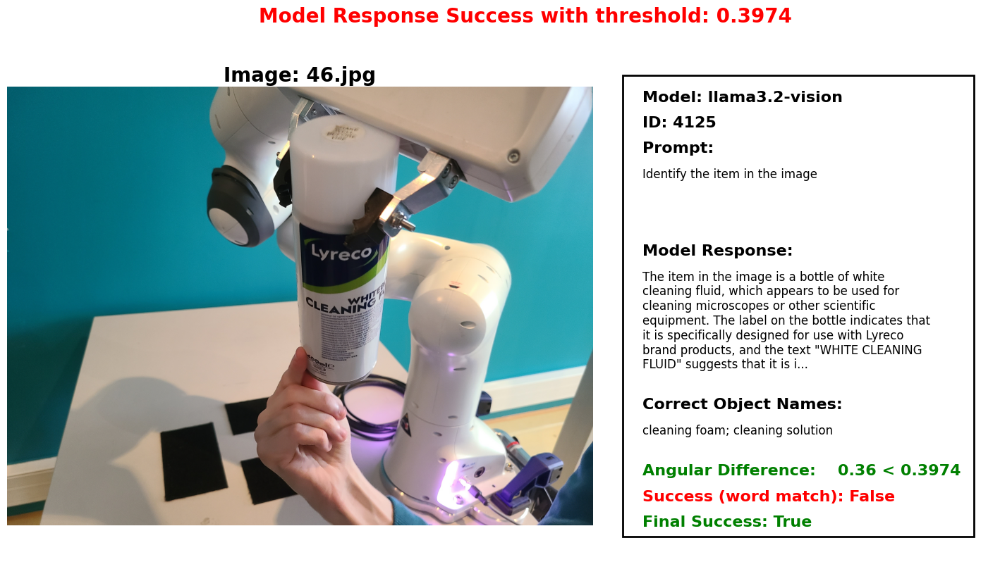

In [25]:
ang_diff_threshold = 0.3974
#full_guesser(responses, np.random.randint(0, len(responses)), threshold=0.3974)
full_guesser(responses, indexes[np.random.randint(0, len(indexes))], threshold=ang_diff_threshold)

In [14]:
indexes = [i for i in range(len(responses)) if int(responses.iloc[i]["image_name"][:2]) in range(33, 38) and responses.iloc[i]["model"] == "llama3.2-vision"]

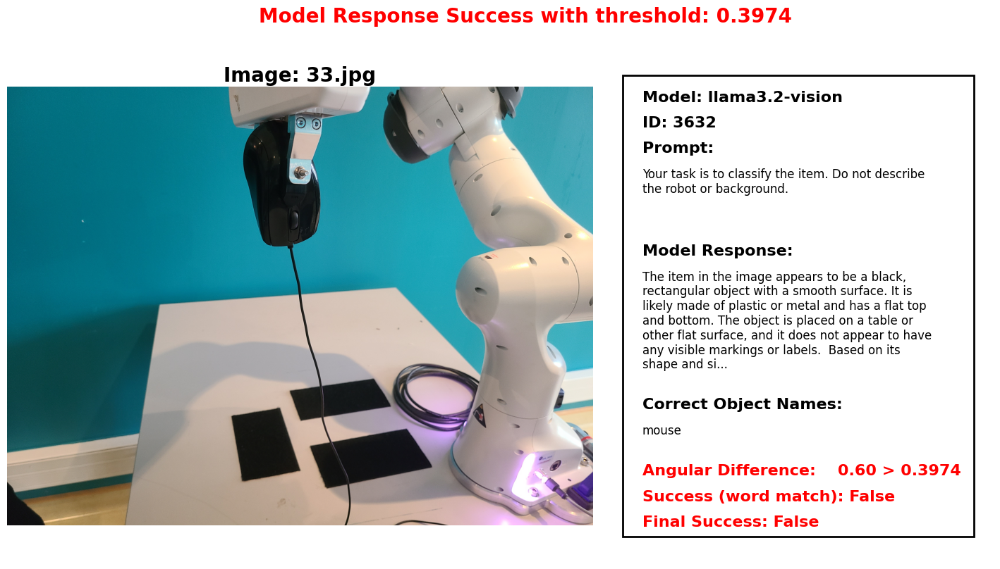

In [17]:
ang_diff_threshold = 0.3974
#full_guesser(responses, np.random.randint(0, len(responses)), threshold=0.3974)
full_guesser(responses, indexes[np.random.randint(0, len(indexes))], threshold=ang_diff_threshold)

---

In [579]:
responses["final_success"] = responses.apply(lambda row: row["success"] or row["angular_difference"] < 0.3974, axis=1)

In [580]:
responses.to_csv("output/responses_with_final_success.csv", index=False)

---

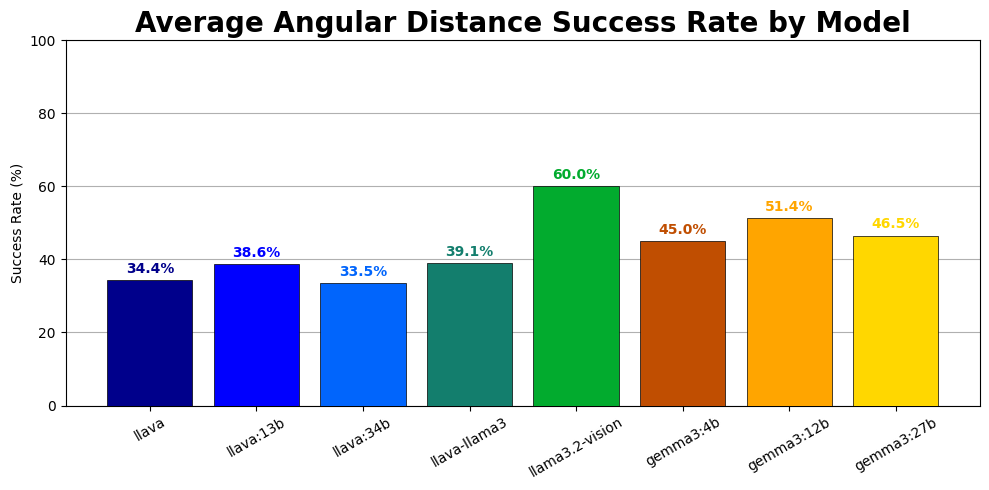

In [51]:
plt.figure(figsize=(10, 5))
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]

plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    success_rate = (responses[responses["model"] == model_name]["angular_difference"] <= 0.3987).mean()
    bar = plt.bar(
        model_name,
        success_rate * 100,
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )
    plt.annotate(
        f'{success_rate:.1%}',
        xy=(i, success_rate*100),
        xytext=(0, 3),
        textcoords="offset points",
        ha='center',
        va='bottom',
        color=colors[i % len(colors)],
        fontweight='bold'
    )

plt.ylim(0, 100)
plt.title("Average Angular Distance Success Rate by Model", fontsize=20, fontweight='bold')
plt.ylabel("Success Rate (%)")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()


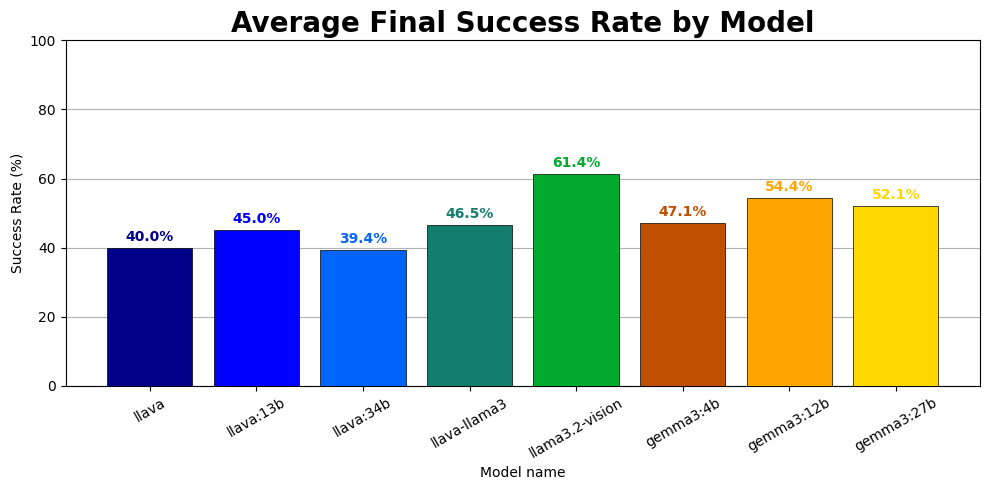

In [40]:
plt.figure(figsize=(10, 5))
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]

plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    success_rate = responses[responses["model"] == model_name]["final_success"].mean()
    bar = plt.bar(
        model_name,
        success_rate * 100,
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )
    plt.annotate(
        f'{success_rate:.1%}',
        xy=(i, success_rate*100),
        xytext=(0, 3),
        textcoords="offset points",
        ha='center',
        va='bottom',
        color=colors[i % len(colors)],
        fontweight='bold'
    )

plt.ylim(0, 100)
plt.title("Average Final Success Rate by Model", fontsize=20, fontweight='bold')
plt.xlabel("Model name")
plt.ylabel("Success Rate (%)")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()


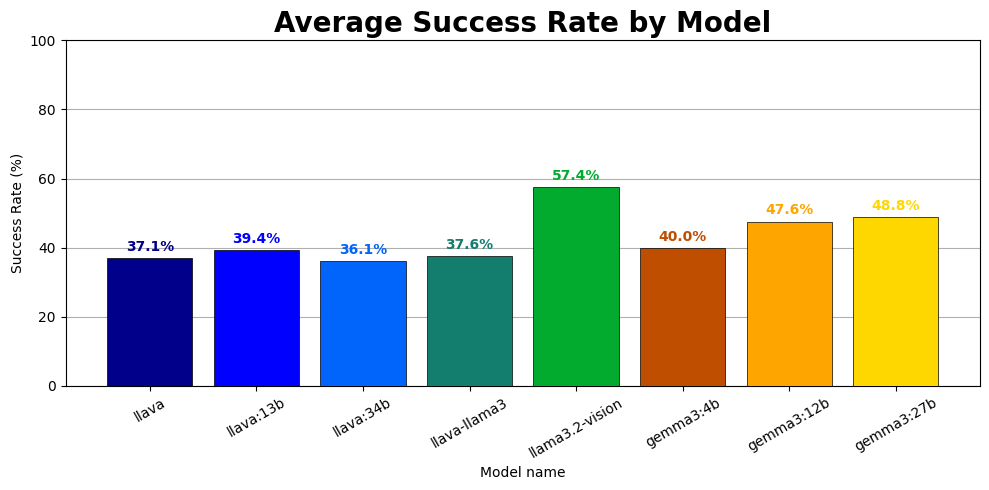

In [39]:
plt.figure(figsize=(10, 5))
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]

plt.grid(axis="y")
for i, model_name in enumerate(responses["model"].unique()):
    success_rate = responses[responses["model"] == model_name]["success"].mean()
    bar = plt.bar(
        model_name,
        success_rate * 100,
        zorder=5,
        color=colors[i % len(colors)],
        edgecolor="black",
        linewidth=0.5,   
    )
    plt.annotate(
        f'{success_rate:.1%}',
        xy=(i, success_rate*100),
        xytext=(0, 3),
        textcoords="offset points",
        ha='center',
        va='bottom',
        color=colors[i % len(colors)],
        fontweight='bold'
    )

plt.ylim(0, 100)
plt.title("Average Success Rate by Model", fontsize=20, fontweight='bold')
plt.xlabel("Model name")
plt.ylabel("Success Rate (%)")
plt.xticks(rotation=30)

plt.tight_layout()
plt.show()


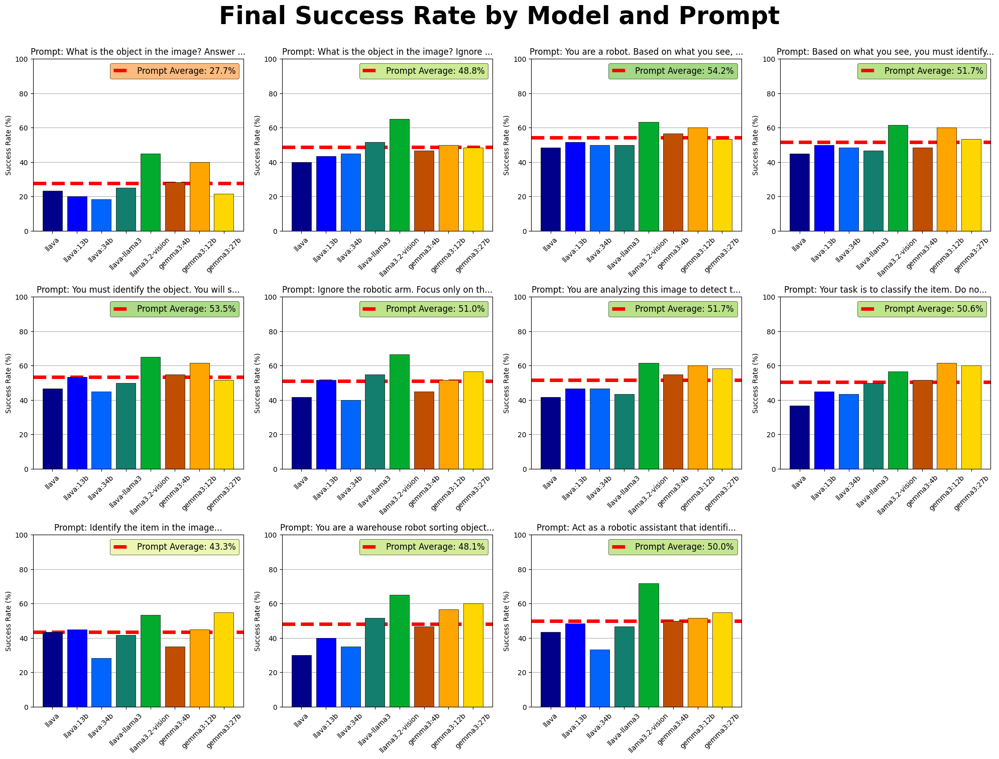

In [58]:
unique_prompts = responses["prompt"].unique()
colors = ["darkblue", "blue", "#0165fc", "#137e6d", "#02ab2e", "#c04e01", "orange", "gold"]
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for idx, prompt in enumerate(unique_prompts[:12]):
    ax = axes[idx]
    ax.grid(axis="y")
    prompt_mean = 0
    for i, model_name in enumerate(responses["model"].unique()):
        differences = responses[(responses["prompt"] == prompt) & (responses["model"] == model_name)]["final_success"]
        
        correct_guess_rate = 100 * differences.mean()
        ax.bar(
            model_name,
            correct_guess_rate,
            #label=model_name,
            zorder=5,
            color=colors[i % len(colors)],
            edgecolor="black",
            linewidth=0.5,   
        )
        prompt_mean += correct_guess_rate
    prompt_mean = prompt_mean / len(responses["model"].unique())
    ax.axhline(prompt_mean, color='red', lw=5, ls='--', label="Prompt Average: " + str(round(prompt_mean, 1)) + "%")
    
    ax.set_ylim(0, 100)
    ax.set_xticks(range(len(responses["model"].unique())))
    ax.set_xticklabels(responses["model"].unique(), rotation=45)
    ax.set_title(f"Prompt: {prompt[:40]}...")
    ax.set_ylabel("Success Rate (%)")
    #ax.legend(fontsize=12)
    legend = ax.legend(fontsize=12)
    legend.get_frame().set_facecolor(plt.cm.RdYlGn((prompt_mean - 10) / (70 - 10)))
    legend.get_frame().set_edgecolor("black")
    legend.get_frame().set_linewidth(0.5)


for idx in range(len(unique_prompts), len(axes)):
    fig.delaxes(axes[idx])

plt.suptitle("Final Success Rate by Model and Prompt", fontsize=35, fontweight='bold', y=1.005)
plt.tight_layout()
plt.show()

Images with 0 success counts across all prompts and models: ['33.jpg', '34.jpg', '35.jpg', '36.jpg', '40.jpg', '47.jpg', '48.jpg']


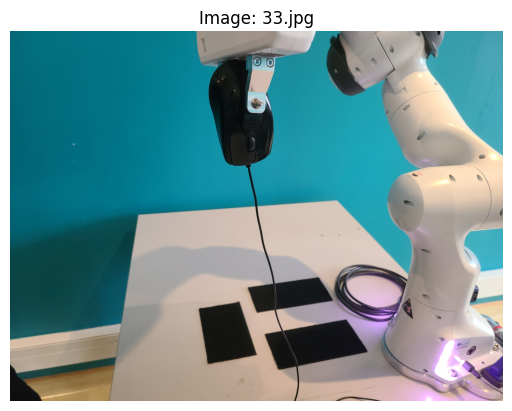

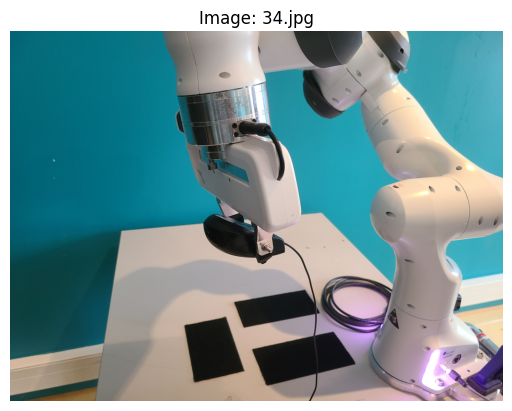

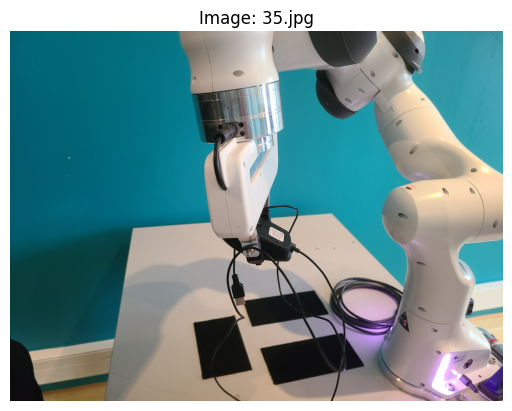

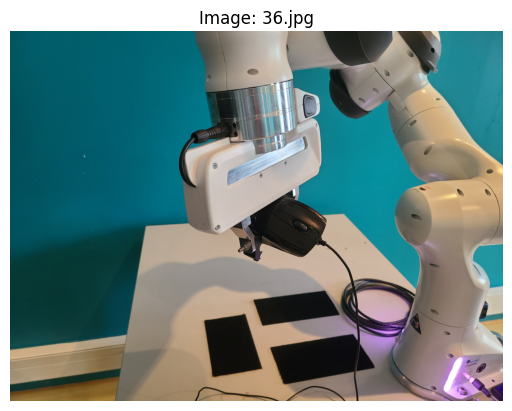

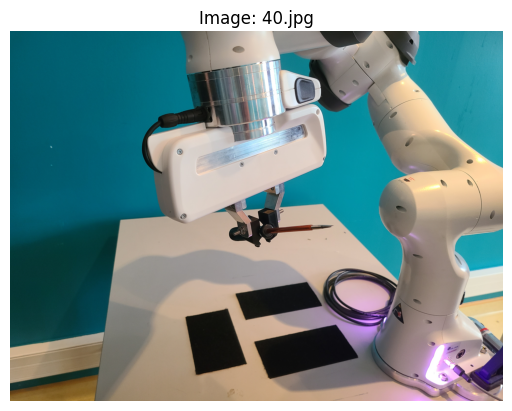

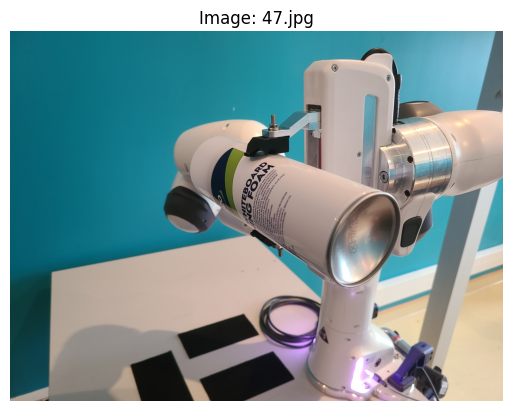

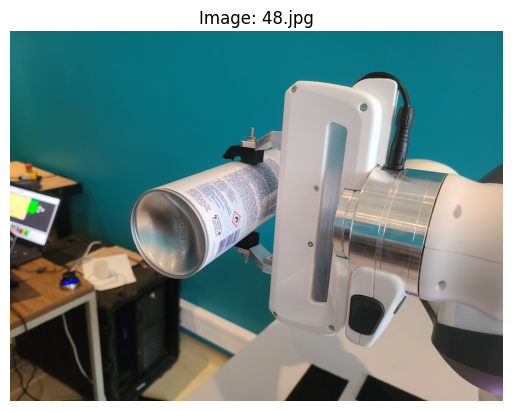

In [67]:
# find the list of images with 0 success counts across all prompts and models out of the first 50 images
image_success_counts = responses[responses["image_name"].str[:2].astype(int) < 50].groupby("image_name")["success"].sum()
zero_success_images = image_success_counts[image_success_counts == 0].index.tolist()
print(f"Images with 0 success counts across all prompts and models: {zero_success_images}")
# show them
for image_name in zero_success_images:
    image_path = "images/" + image_name
    try:
        img = Image.open(image_path)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Image: {image_name}")
        plt.show()
    except FileNotFoundError:
        print(f"Image file not found: {image_path}")

In [62]:
responses[responses["image_name"] == lowest_success_image]["model_response"]
# rank that in ascending order of angular difference
responses[responses["image_name"] == lowest_success_image].sort_values("angular_difference", ascending=True)[["model", "angular_difference", "success", "model_response"]]

,model,angular_difference,success,model_response
932,gemma3:27b,0.422554,False,Board.
212,llava-llama3,0.423121,False,Machine
2072,llava:34b,0.426198,False,The object is a robotic arm with a gripper at ...
1472,llava,0.436653,False,The object in the image is a robotic arm.
992,llava,0.436653,False,The object in the image is a robotic arm.
...,...,...,...,...
4652,gemma3:4b,0.623582,False,"Based on the image, I am currently holding a s..."
1232,llama3.2-vision,0.624010,False,The object is a black square piece of material...
1292,gemma3:4b,0.633122,False,Black tape.
2312,gemma3:12b,0.633122,False,Black tape.
